In [1]:
# Test Phase
# import necessary libraries
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision import models
import numpy as np
import matplotlib.pyplot as plt
import time
from PIL import Image
import os
import shutil
import torchvision.models as models
import requests
# Define transformations
transforms_train = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

transforms_val = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Gradient Reversal Layer
class GradientReversalLayer(torch.autograd.Function):
    @staticmethod
    def forward(ctx, x, alpha):
        ctx.alpha = alpha
        return x.view_as(x)

    @staticmethod
    def backward(ctx, grad_output):
        return grad_output.neg() * ctx.alpha, None
    
    
transforms_test = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
])

# Evaluation
def evaluate(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0
    correct_female = 0
    total_female = 0
    correct_male = 0
    total_male = 0

    with torch.no_grad():
        for data, labels in test_loader:
            data, labels = data.to(device), labels.to(device)
            task_output, _ = model(data)  # Ensure your model returns both outputs properly
            _, predicted = torch.max(task_output, 1)

            # Overall accuracy
            correct += (predicted == labels).sum().item()
            total += labels.size(0)

            # Female accuracy (assuming class 0 is female)
            female_mask = labels == 0
            correct_female += (predicted[female_mask] == labels[female_mask]).sum().item()
            total_female += female_mask.sum().item()

            # Male accuracy (assuming class 1 is male)
            male_mask = labels == 1
            correct_male += (predicted[male_mask] == labels[male_mask]).sum().item()
            total_male += male_mask.sum().item()

    # Print results
    print(f"Test Accuracy: {correct / total:.4f}")
    if total_female > 0:
        print(f"Female Accuracy: {correct_female / total_female:.4f}")
    else:
        print("No female samples in the test set.")

    if total_male > 0:
        print(f"Male Accuracy: {correct_male / total_male:.4f}")
    else:
        print("No male samples in the test set.")
    

class DANNModel(nn.Module):
    def __init__(self, feature_dim, num_classes, num_domains, input_shape=(3, 224, 224)):
        super(DANNModel, self).__init__()
        self.feature_extractor = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=5),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d(2),
            nn.Conv2d(64, 128, kernel_size=5),
            nn.BatchNorm2d(128),
            nn.ReLU(),
            nn.MaxPool2d(2),
        )

        # Dynamically calculate the flattened size
        with torch.no_grad():
            dummy_input = torch.zeros(1, *input_shape)
            flattened_size = self.feature_extractor(dummy_input).view(1, -1).size(1)

        self.feature_extractor.add_module("Flatten", nn.Flatten())
        self.feature_extractor.add_module("FC", nn.Linear(flattened_size, feature_dim))
        self.feature_extractor.add_module("ReLU", nn.ReLU())

        # Task Classifier
        self.task_classifier = nn.Sequential(
            nn.Linear(feature_dim, 100),
            nn.ReLU(),
            nn.Linear(100, num_classes)
        )

        # Domain Classifier
        self.domain_classifier = nn.Sequential(
            nn.Linear(feature_dim, 100),
            nn.ReLU(),
            nn.Linear(100, num_domains)
        )

    def forward(self, x, alpha=0.0):
        features = self.feature_extractor(x)
        task_output = self.task_classifier(features)

        # Gradient Reversal Layer for domain classification
        reversed_features = GradientReversalLayer.apply(features, alpha)
        domain_output = self.domain_classifier(reversed_features)

        return task_output, domain_output
task_criterion = nn.CrossEntropyLoss()  # Task-specific loss
domain_criterion = nn.CrossEntropyLoss()  # Domain alignment loss

# Assuming all models are ResNet18 with the same architecture
def load_model(model_path, device):
    model = models.resnet18(pretrained=True)
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, 2)  # Output layer for binary classification
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model

def load_dann_model(model_path, device):
    model = DANNModel(feature_dim=256, num_classes=2, num_domains=2)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model

In [3]:
def imshow(input, title):
    # Convert torch.Tensor to numpy array
    input = input.numpy().transpose((1, 2, 0))
    # Undo image normalization
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    input = std * input + mean
    input = np.clip(input, 0, 1)
    # Display images
    plt.imshow(input)
    plt.title(title)
    plt.show()

aaf_dataset_path = "../Pseudo-Labeling/gender_classification_dataset_asia"
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# Load the model weights
balanced_test_folder = os.path.join(aaf_dataset_path, "Test_balanced")
# Now the model is ready for inference
batch_size = 16
balanced_test_dataset = ImageFolder(balanced_test_folder, transform=transforms_val)
balanced_test_dataloader = DataLoader(balanced_test_dataset, batch_size=batch_size, shuffle=True, num_workers=4)
# Define the URL for the file
url = "https://postechackr-my.sharepoint.com/:u:/g/personal/dongbinna_postech_ac_kr/EVd9bFWzqztMrXRDdNnCHQkBsHaM4n5_1q1fue77vtQVtw?download=1"
# Define the path where the file will be saved
output_path = "classification_model.pth"
# Send a GET request to download the file
response = requests.get(url)
# Check if the request was successful (status code 200)
if response.status_code == 200:
    with open(output_path, "wb") as file:
        file.write(response.content)  # Write the content of the response to the file
    print(f"File downloaded successfully and saved as {output_path}")
else:
    print(f"Failed to download file. Status code: {response.status_code}")
    # Load pre-trained weights from .pth file

model = models.resnet18(pretrained=True)
num_features = model.fc.in_features
model.fc = nn.Linear(num_features, 2)  # Output layer for binary classification

pretrained_weights_path = 'classification_model.pth'
model.load_state_dict(torch.load(pretrained_weights_path, map_location=device))
model.to(device)

class_names = balanced_test_dataset.classes
print('Class names:', class_names)
criterion = nn.CrossEntropyLoss()

# Model paths for different models
model_balanced_06_fixmatch_iteration_3 = '../Pseudo-Labeling/10_iterations_0.6_3_balanced_best.pth'
model_balanced_09_fixmatch_iteration_7_lowest_disparity = '../Pseudo-Labeling/method_1_0.9_7_balanced_best.pth'
model_balanced_09_fixmatch_iteration_12 = '../Pseudo-Labeling/method_1_0.9_12_balanced_best.pth'
model_balanced_06_flexmatch_iteration_4 = '../Pseudo-Labeling/FlexMatch_4_best.pth'
model_balanced_06_flexmatch_iteration_6_lowest_disparity = '../Pseudo-Labeling/FlexMatch_6_best.pth'
model_unbalanced_09_fixmatch_iteration_3 = '../Pseudo-Labeling/method_1_model-0.9_3_unbalanced_best.pth'
DANN_model = '../Unsupervised-Domain/dann_model.pth'

models_dict = {
    'balanced_06_fixmatch_iteration_3': load_model(model_balanced_06_fixmatch_iteration_3, device),
    'balanced_09_fixmatch_iteration_7_lowest_disparity': load_model(model_balanced_09_fixmatch_iteration_7_lowest_disparity, device),
    'balanced_09_fixmatch_iteration_12': load_model(model_balanced_09_fixmatch_iteration_12, device),
    'balanced_06_flexmatch_iteration_4': load_model(model_balanced_06_flexmatch_iteration_4, device),
    'balanced_06_flexmatch_iteration_6_lowest_disparity': load_model(model_balanced_06_flexmatch_iteration_6_lowest_disparity, device),
    'unbalanced_09_fixmatch_iteration_3': load_model(model_unbalanced_09_fixmatch_iteration_3, device)
}
dann_model_dict = {
    'DANN_model': load_dann_model(DANN_model, device)
}

def collect_predictions(models_dict, dataloader, device):
    all_preds = {model_name: [] for model_name in models_dict}
    all_labels = []
    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            all_labels.extend(labels.cpu().numpy())
            for model_name, model in models_dict.items():
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                all_preds[model_name].extend(preds.cpu().numpy())
    return all_preds, np.array(all_labels)


def collect_dann_predictions(models_dict, dataloader, device):
    correct = 0
    total = 0
    correct_female = 0
    total_female = 0
    correct_male = 0
    total_male = 0
    all_labels = []
    all_preds = {model_name: [] for model_name in models_dict}

    with torch.no_grad():
        for data, labels in dataloader:
            data, labels = data.to(device), labels.to(device)
            for model_name, model in models_dict.items():
                model.eval()
                task_output, _ = model(data)
                _, predicted = torch.max(task_output, 1)
                all_labels.extend(labels.cpu().numpy())
                all_preds[model_name].extend(predicted.cpu().numpy())
                # Overall accuracy
                correct += (predicted == labels).sum().item()
                total += labels.size(0)
                # Female accuracy (assuming class 0 is female)
                female_mask = labels == 0
                correct_female += (predicted[female_mask] == labels[female_mask]).sum().item()
                total_female += female_mask.sum().item()

                # Male accuracy (assuming class 1 is male)
                male_mask = labels == 1
                correct_male += (predicted[male_mask] == labels[male_mask]).sum().item()
                total_male += male_mask.sum().item()

        # Print results
        print(f"Test Accuracy: {correct / total:.4f}")
        if total_female > 0:
            print(f"Female Accuracy: {correct_female / total_female:.4f}")
            print(correct_female)
            print(total_female)
        else:
            print("No female samples in the test set.")

        if total_male > 0:
            print(f"Male Accuracy: {correct_male / total_male:.4f}")
            print(correct_male)
            print(total_male)
        else:
            print("No male samples in the test set.")
        return all_preds, np.array(all_labels)

def analyze_predictions(all_preds, all_labels, class_names):
    num_samples = len(all_labels)
    print("Size of balanced test set:", num_samples)
    results = {
        'all_wrong': [],
        'all_correct': [],
        'disagreements': {model_name: [] for model_name in all_preds}
    }
    
    for i in range(num_samples):
        preds = {model_name: all_preds[model_name][i] for model_name in all_preds}
        label = all_labels[i]
        # All models wrong
        if all(p != label for p in preds.values()):
            results['all_wrong'].append(i)
        # All models correct
        if all(p == label for p in preds.values()):
            results['all_correct'].append(i)
        # Disagreements
        for model_name, prediction in preds.items():
            if prediction != label:
                results['disagreements'][model_name].append(i)
    return results

all_preds, all_labels = collect_predictions(models_dict, balanced_test_dataloader, device)
all_preds_dann, all_labels_dann = collect_dann_predictions(dann_model_dict, balanced_test_dataloader, device)
all_preds['DANN_model'] = all_preds_dann['DANN_model']
# add labels together

for keys,values in all_preds.items():
    print(keys)
    print(values)

analysis_results = analyze_predictions(all_preds, all_labels, class_names)
print("All models wrong: ", len(analysis_results['all_wrong']))
print("All models correct: ", len(analysis_results['all_correct']))
print("Disagreements for balanced_06_fixmatch_iteration_3: ", len(analysis_results['disagreements']['balanced_06_fixmatch_iteration_3']))
print("Disagreements for balanced_09_fixmatch_iteration_7_lowest_disparity: ",  len(analysis_results['disagreements']['balanced_09_fixmatch_iteration_7_lowest_disparity']))
print("Disagreements for balanced_09_fixmatch_iteration_12: ",  len(analysis_results['disagreements']['balanced_09_fixmatch_iteration_12']))
print("Disagreements for balanced_06_flexmatch_iteration_4: ", len(analysis_results['disagreements']['balanced_06_flexmatch_iteration_4']))
print("Disagreements for balanced_06_flexmatch_iteration_6_lowest_disparity: ", len(analysis_results['disagreements']['balanced_06_flexmatch_iteration_6_lowest_disparity']))
print("Disagreements for unbalanced_09_fixmatch_iteration_3: ", len(analysis_results['disagreements']['unbalanced_09_fixmatch_iteration_3']))
print("Disagreements for DANN_model: ", len(analysis_results['disagreements']['DANN_model']))


# sav to csv all_wrong and all_correct
import csv
import os
import pandas as pd
def save_to_csv(data, filename):
    with open(filename, 'w', newline='') as file:
        writer = csv.writer(file)
        writer.writerow(["Image", "Label"])
        for i in data:
            writer.writerow([i, class_names[all_labels[i]]])
        



File downloaded successfully and saved as classification_model.pth


c:\Users\haohu\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\haohu\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\haohu\AppData\Local\Temp\ipykernel_11892\1217467026.py:42: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpick

Class names: ['female', 'male']


C:\Users\haohu\AppData\Local\Temp\ipykernel_11892\3147354437.py:148: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=

Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
balanced_06_fixmatch_iteration_3
[0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 1, 1, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 1, 1, 

In [4]:
import pandas as pd
import numpy as np
import torch
import random

def set_seed(seed):
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    random.seed(seed)

def collect_predictions(models_dict, dataloader, device):
    all_preds = {model_name: [] for model_name in models_dict}
    all_labels = []
    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            all_labels.extend(labels.cpu().numpy())
            for model_name, model in models_dict.items():
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                all_preds[model_name].extend(preds.cpu().numpy())
    return all_preds, np.array(all_labels)


def collect_dann_predictions(models_dict, dataloader, device):
    correct = 0
    total = 0
    correct_female = 0
    total_female = 0
    correct_male = 0
    total_male = 0
    all_labels = []
    all_preds = {model_name: [] for model_name in models_dict}

    with torch.no_grad():
        for data, labels in dataloader:
            data, labels = data.to(device), labels.to(device)
            for model_name, model in models_dict.items():
                model.eval()
                task_output, _ = model(data)
                _, predicted = torch.max(task_output, 1)
                all_labels.extend(labels.cpu().numpy())
                all_preds[model_name].extend(predicted.cpu().numpy())
                # Overall accuracy
                correct += (predicted == labels).sum().item()
                total += labels.size(0)
                # Female accuracy (assuming class 0 is female)
                female_mask = labels == 0
                correct_female += (predicted[female_mask] == labels[female_mask]).sum().item()
                total_female += female_mask.sum().item()

                # Male accuracy (assuming class 1 is male)
                male_mask = labels == 1
                correct_male += (predicted[male_mask] == labels[male_mask]).sum().item()
                total_male += male_mask.sum().item()

        # Print results
        print(f"Test Accuracy: {correct / total:.4f}")
        if total_female > 0:
            print(f"Female Accuracy: {correct_female / total_female:.4f}")
            print(correct_female)
            print(total_female)
        else:
            print("No female samples in the test set.")

        if total_male > 0:
            print(f"Male Accuracy: {correct_male / total_male:.4f}")
            print(correct_male)
            print(total_male)
        else:
            print("No male samples in the test set.")
        return all_preds, np.array(all_labels)

def analyze_predictions(all_preds, all_labels, class_names):
    num_samples = len(all_labels)
    print("Size of balanced test set:", num_samples)
    results = {
        'all_wrong': [],
        'all_correct': [],
        'disagreements': {model_name: [] for model_name in all_preds}
    }
    
    for i in range(num_samples):
        preds = {model_name: all_preds[model_name][i] for model_name in all_preds}
        label = all_labels[i]
        # All models wrong
        if all(p != label for p in preds.values()):
            results['all_wrong'].append(i)
        # All models correct
        if all(p == label for p in preds.values()):
            results['all_correct'].append(i)
        # Disagreements
        for model_name, prediction in preds.items():
            if prediction != label:
                results['disagreements'][model_name].append(i)
    return results



def load_model(model_path, device):
    model = models.resnet18(pretrained=True)
    num_features = model.fc.in_features
    model.fc = nn.Linear(num_features, 2)  # Output layer for binary classification
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model

def load_dann_model(model_path, device):
    model = DANNModel(feature_dim=256, num_classes=2, num_domains=2)
    model.load_state_dict(torch.load(model_path, map_location=device))
    model.to(device)
    model.eval()
    return model

def run_experiment(dataloader, device, num_runs=10):
    results = []
    
    for run in range(num_runs):
        print(f"Run {run}")
        set_seed(run)  # Ensure reproducibility
        # Model paths
        model_paths = {
            'balanced_06_fixmatch_iteration_3': '../Pseudo-Labeling/10_iterations_0.6_3_balanced_best.pth',
            'balanced_09_fixmatch_iteration_7_lowest_disparity': '../Pseudo-Labeling/method_1_0.9_7_balanced_best.pth',
            'balanced_09_fixmatch_iteration_12': '../Pseudo-Labeling/method_1_0.9_12_balanced_best.pth',
            'balanced_06_flexmatch_iteration_4': '../Pseudo-Labeling/FlexMatch_4_best.pth',
            'balanced_06_flexmatch_iteration_6_lowest_disparity': '../Pseudo-Labeling/FlexMatch_6_best.pth',
            'unbalanced_09_fixmatch_iteration_3': '../Pseudo-Labeling/method_1_model-0.9_3_unbalanced_best.pth',
        }

        # Load models
        models_dict = {name: load_model(path, device) for name, path in model_paths.items()}
        dann_model_dict = {'DANN_model': load_dann_model('../Unsupervised-Domain/dann_model.pth', device)}

        # Collect predictions
        all_preds, all_labels = collect_predictions(models_dict, dataloader, device)
        all_preds_dann, all_labels_dann = collect_dann_predictions(dann_model_dict, dataloader, device)
        all_preds['DANN_model'] = all_preds_dann['DANN_model']

        # Analyze results
        analysis_results = analyze_predictions(all_preds, all_labels, class_names)

        # Separate results by label
        male_indices = np.where(all_labels == 1)[0]
        female_indices = np.where(all_labels == 0)[0]

        def count_disagreements(indices, model_disagreements):
            return sum(1 for i in indices if i in model_disagreements)

        run_data = {"Run": run}

        # Store general stats
        run_data["All Wrong"] = len(analysis_results['all_wrong'])
        run_data["All Correct"] = len(analysis_results['all_correct'])

        # Separate male/female stats
        run_data["All Wrong Male"] = sum(1 for i in male_indices if i in analysis_results['all_wrong'])
        run_data["All Wrong Female"] = sum(1 for i in female_indices if i in analysis_results['all_wrong'])

        run_data["All Correct Male"] = sum(1 for i in male_indices if i in analysis_results['all_correct'])
        run_data["All Correct Female"] = sum(1 for i in female_indices if i in analysis_results['all_correct'])

        for model_name in models_dict.keys():
            run_data[f"Disagreements {model_name}"] = len(analysis_results['disagreements'][model_name])
            run_data[f"Disagreements {model_name} Male"] = count_disagreements(male_indices, analysis_results['disagreements'][model_name])
            run_data[f"Disagreements {model_name} Female"] = count_disagreements(female_indices, analysis_results['disagreements'][model_name])

        results.append(run_data)
    
    return results

# Run experiments
num_runs = 10
results = run_experiment(balanced_test_dataloader, device, num_runs)

# Convert to DataFrame
df = pd.DataFrame(results)

# Compute mean and std
df_mean = df.mean()
df_std = df.std()

# Save results
df.to_csv("model_evaluation_results.csv", index=False)
df_mean.to_csv("model_evaluation_results_mean.csv")
df_std.to_csv("model_evaluation_results_std.csv")

print("Results saved successfully!")

Run 0


C:\Users\haohu\AppData\Local\Temp\ipykernel_11892\4249680203.py:105: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=

Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 1
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 2
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 3
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 4
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 5
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 6
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 7
Test Accuracy: 0.7916
Female Accuracy: 0.8827
1114
1262
Male Accuracy: 0.7005
884
1262
Size of balanced test set: 2524
Run 8


female


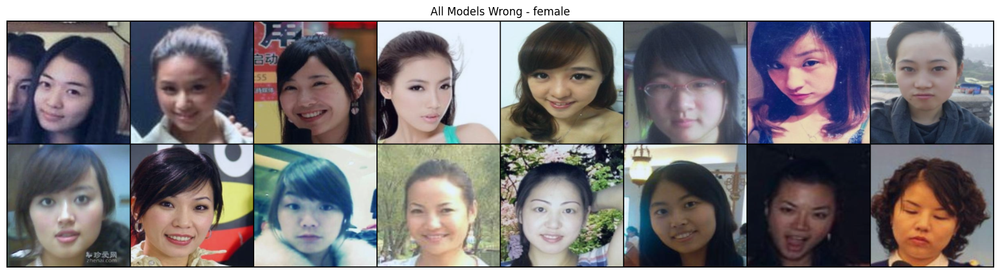

male


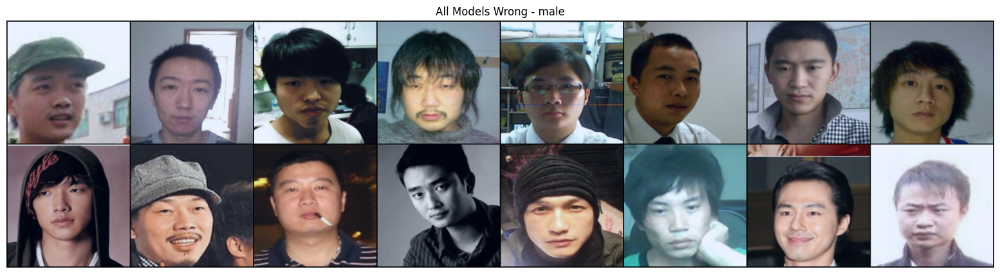

female


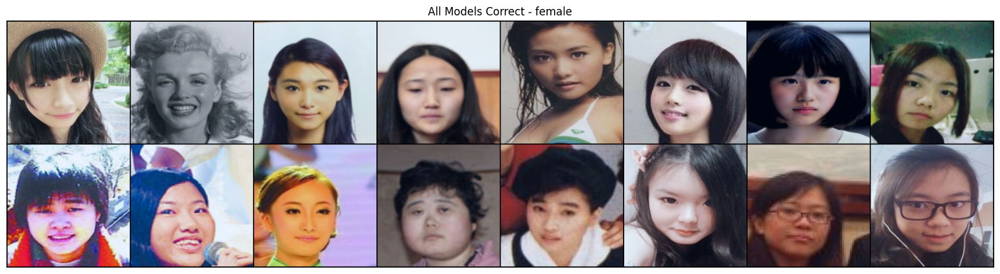

male


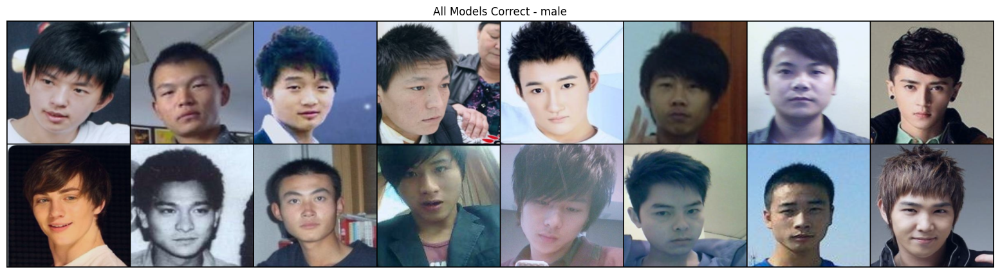

female


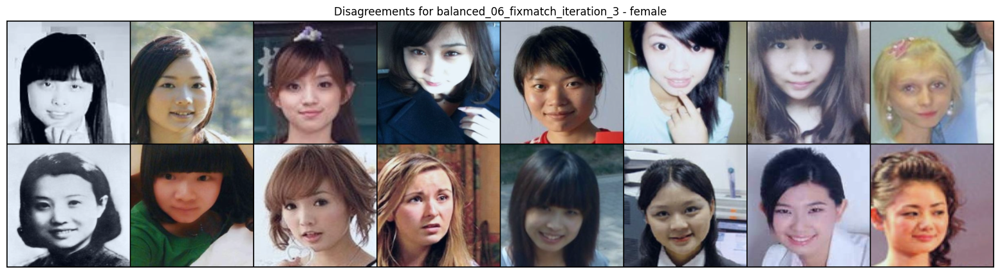

male


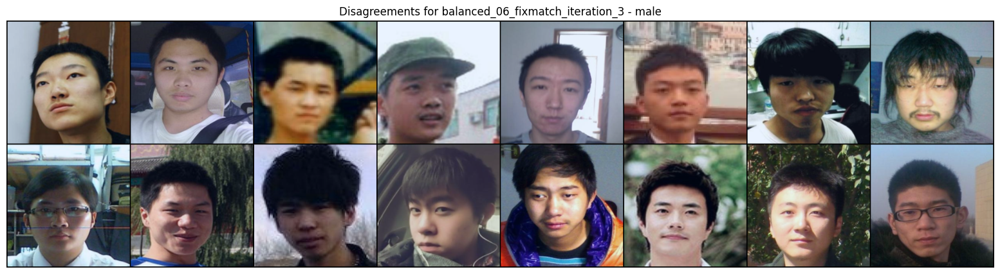

female


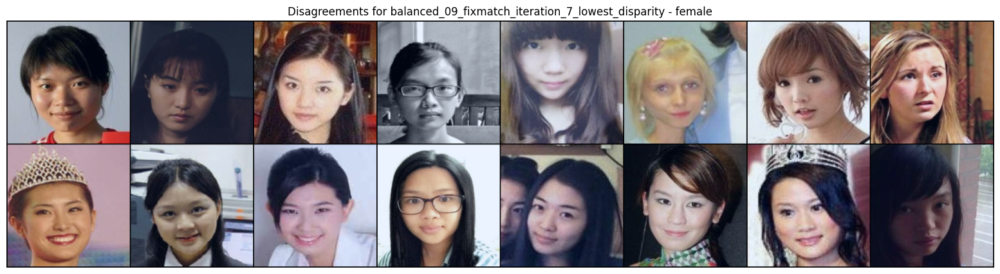

male


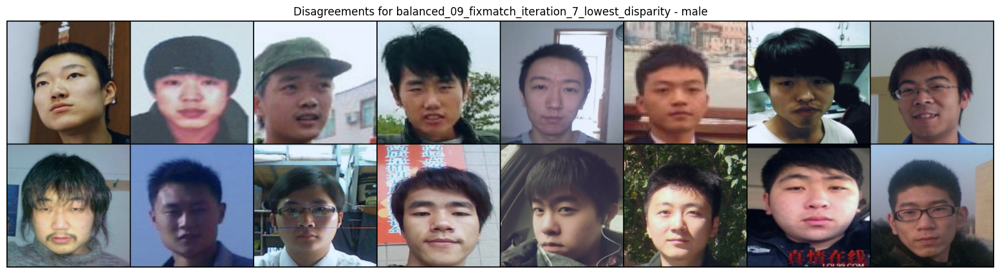

female


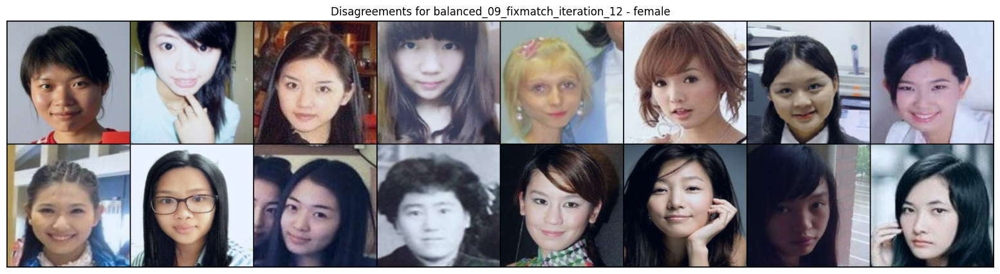

male


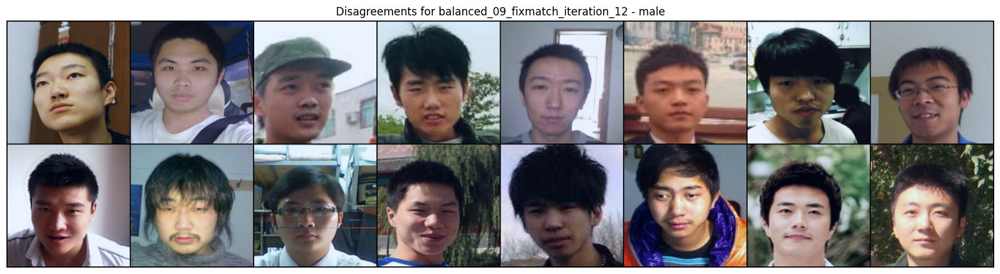

female


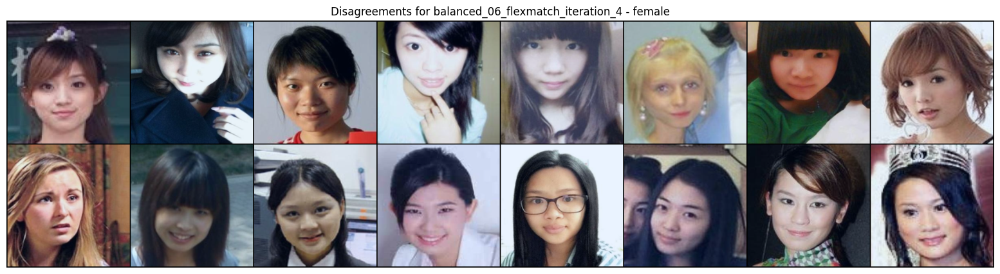

male


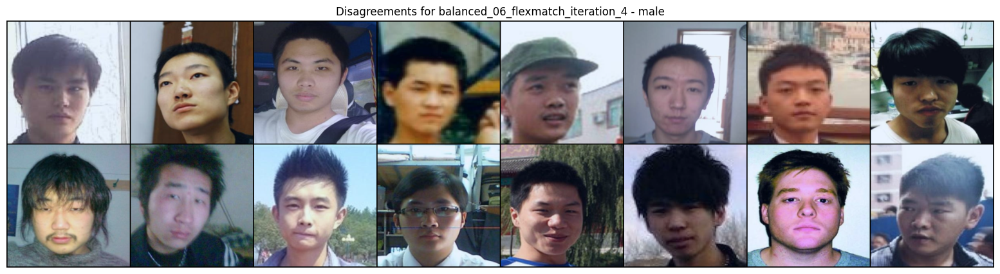

female


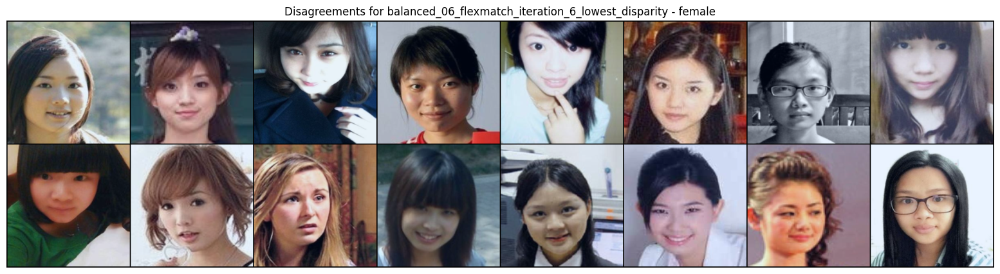

male


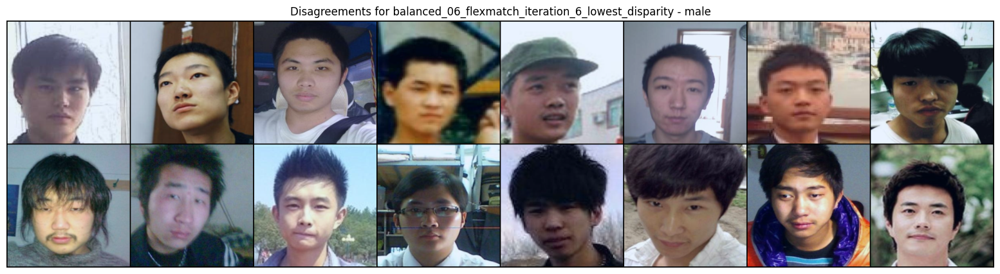

female


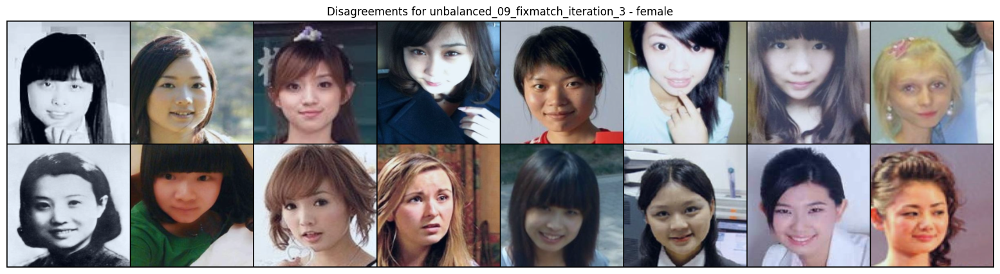

male


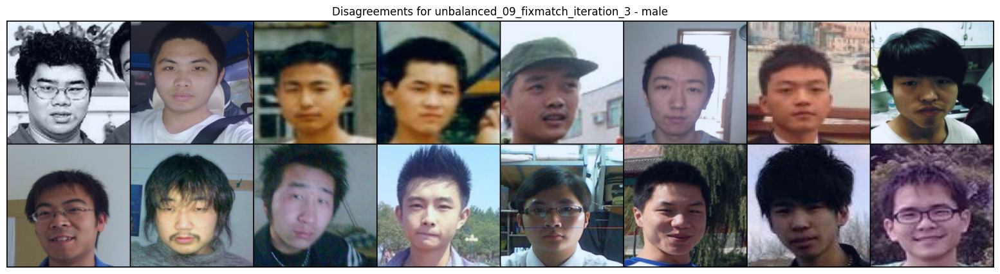

female


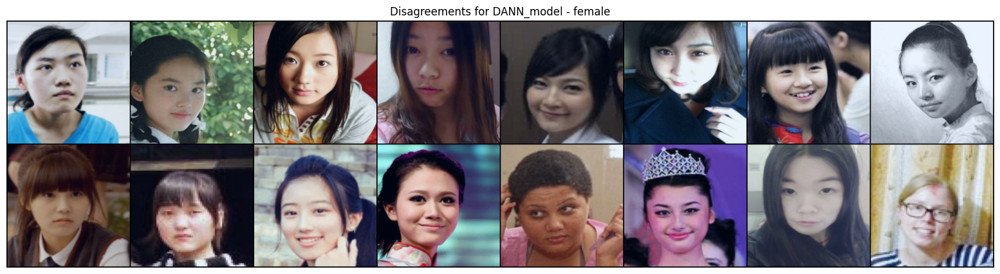

male


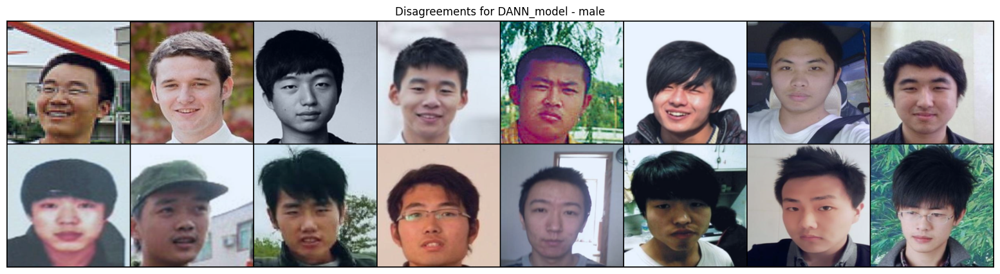

In [5]:

def visualize_group(dataset, indices, title):
    images = []
    labels = []
    for idx in indices[:16]:  # Get first 16 images
        img, label = dataset[idx]
        if isinstance(img, torch.Tensor):
            img = img.cpu()  # Ensure it's on the CPU
        images.append(img)
        labels.append(class_names[label])  # Store labels for title
    # Convert list of images to a single batch tensor
    images = torch.stack(images)  # Stack images into a batch
    images = torchvision.utils.make_grid(images, padding=2, normalize=True)  # Arrange horizontally
    # Plot the image grid
    plt.figure(figsize=(20, 5))
    plt.imshow(images.permute(1, 2, 0))  # Convert from (C, H, W) to (H, W, C)
    plt.axis("off")
    plt.title(title)
    plt.savefig(title + '.png')
    plt.show()

def visualize_group_by_label(dataset, indices, title):
    label_groups = {}  # Dictionary to group indices by label
    for idx in indices: # for each index in the list
        _, label = dataset[idx] # get image and label
        if label not in label_groups:
            label_groups[label] = []
        label_groups[label].append(idx)

    for label, label_indices in label_groups.items():
        label_name = class_names[label]  # Get human-readable label
        print(label_name)
        # Get first 16 per label (if available)
        selected_indices = label_indices[:16] if len(label_indices) > 16 else label_indices
        if selected_indices:
            visualize_group(dataset, selected_indices, f"{title} - {label_name}")

# Visualize wrong predictions by label
visualize_group_by_label(balanced_test_dataset, analysis_results['all_wrong'], 'All Models Wrong')

# Visualize correct predictions by label
visualize_group_by_label(balanced_test_dataset, analysis_results['all_correct'], 'All Models Correct')

# Visualize disagreements
for model_name, indices in analysis_results['disagreements'].items():
    visualize_group_by_label(balanced_test_dataset, indices, f'Disagreements for {model_name}')

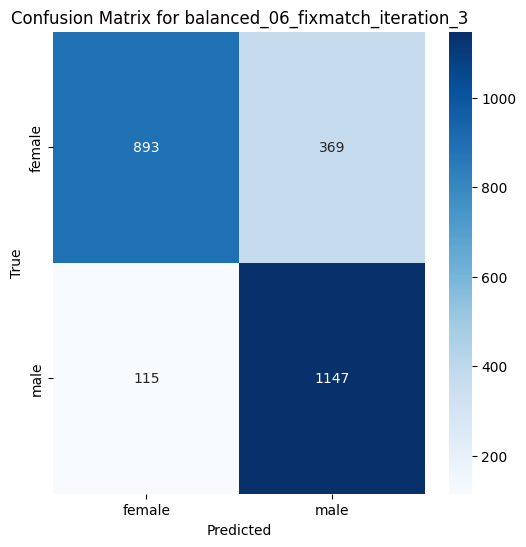

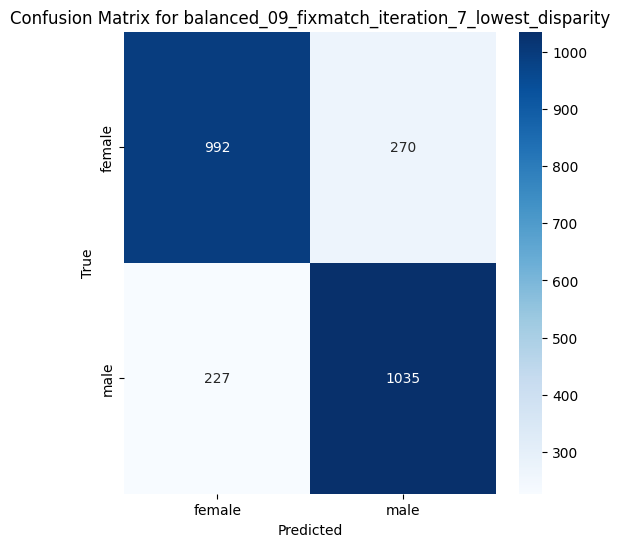

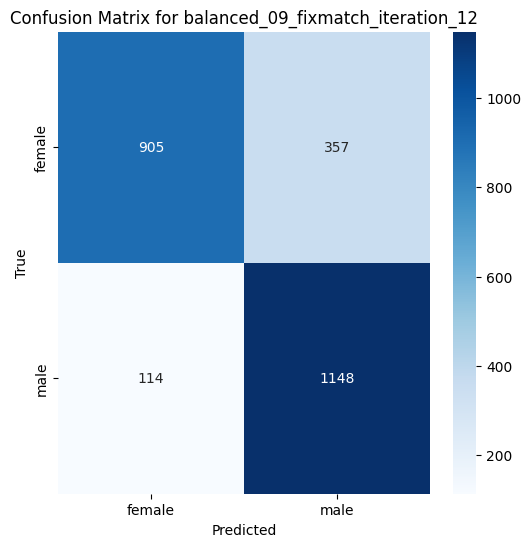

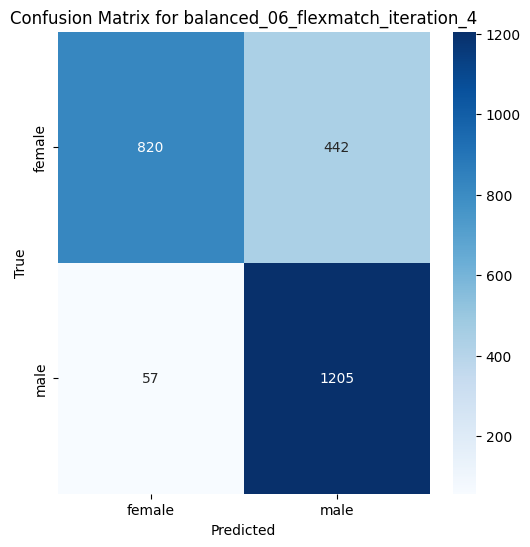

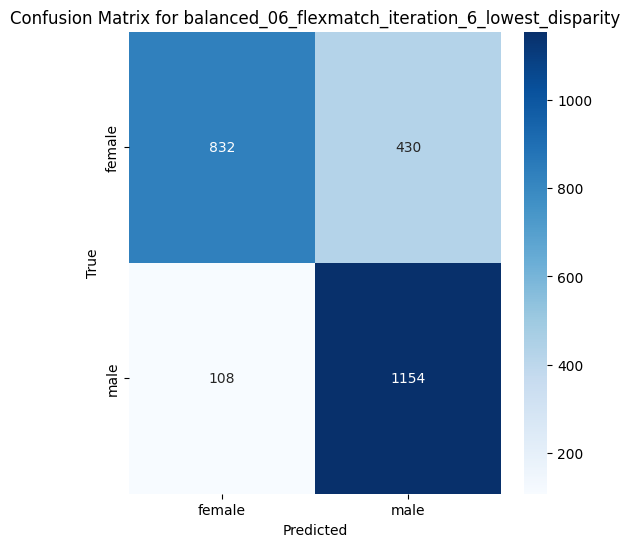

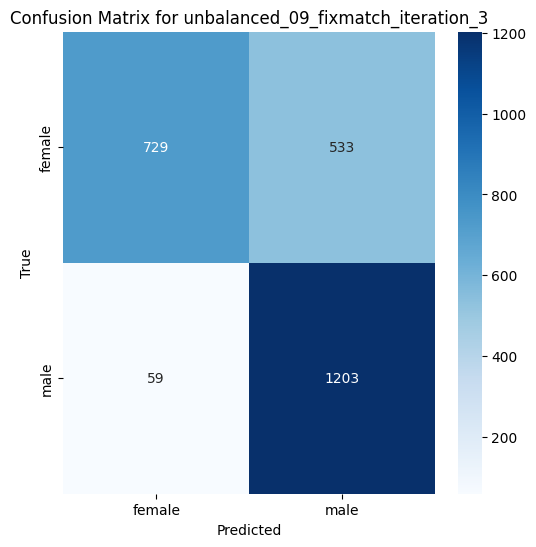

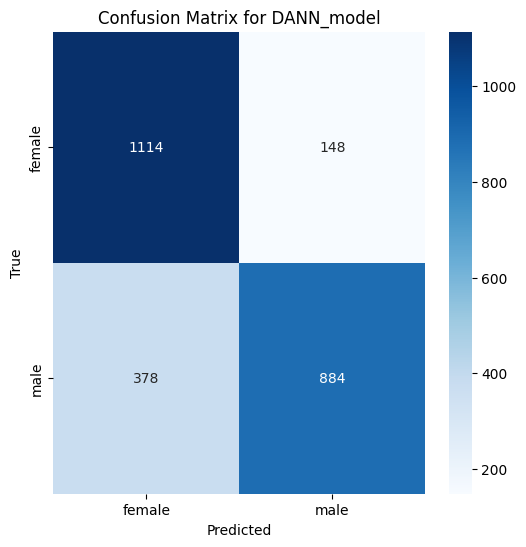

Model: balanced_06_fixmatch_iteration_3
Male Accuracy: 0.9089
Female Accuracy: 0.7076
False Positive Rate (FPR): 0.2924
False Negative Rate (FNR): 0.0911

Model: balanced_09_fixmatch_iteration_7_lowest_disparity
Male Accuracy: 0.8201
Female Accuracy: 0.7861
False Positive Rate (FPR): 0.2139
False Negative Rate (FNR): 0.1799

Model: balanced_09_fixmatch_iteration_12
Male Accuracy: 0.9097
Female Accuracy: 0.7171
False Positive Rate (FPR): 0.2829
False Negative Rate (FNR): 0.0903

Model: balanced_06_flexmatch_iteration_4
Male Accuracy: 0.9548
Female Accuracy: 0.6498
False Positive Rate (FPR): 0.3502
False Negative Rate (FNR): 0.0452

Model: balanced_06_flexmatch_iteration_6_lowest_disparity
Male Accuracy: 0.9144
Female Accuracy: 0.6593
False Positive Rate (FPR): 0.3407
False Negative Rate (FNR): 0.0856

Model: unbalanced_09_fixmatch_iteration_3
Male Accuracy: 0.9532
Female Accuracy: 0.5777
False Positive Rate (FPR): 0.4223
False Negative Rate (FNR): 0.0468

Model: DANN_model
Male Accuracy

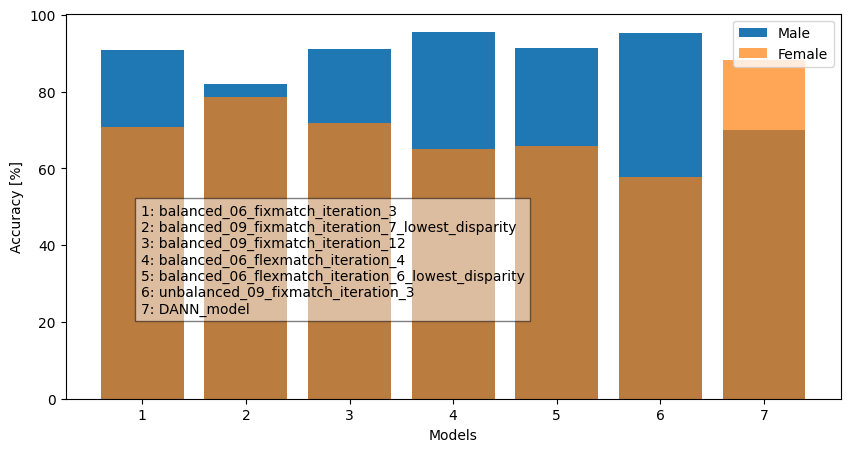

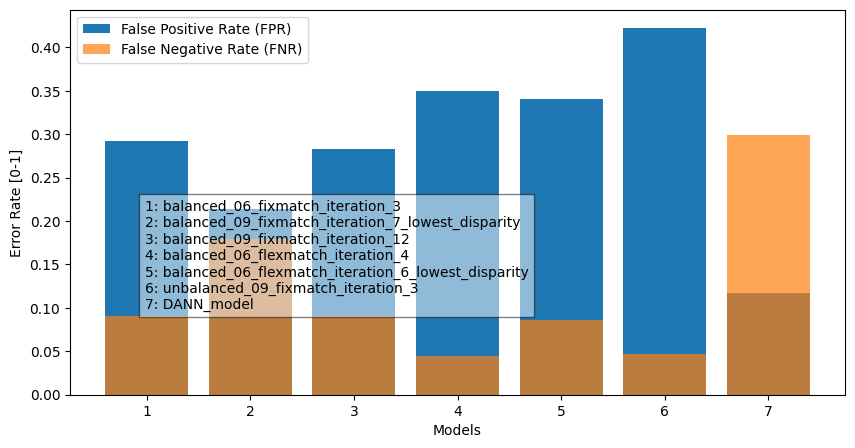

In [6]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt

plt.fontsize = 12
plt.fontFamily = 'Arial'

def compute_confusion_matrices(all_preds, all_labels, class_names):
    confusion_matrices = {}
    for model_name, preds in all_preds.items():
        cm = confusion_matrix(all_labels, preds)
        confusion_matrices[model_name] = cm
    return confusion_matrices


confusion_matrices = compute_confusion_matrices(all_preds, all_labels, class_names)

confusion_matrices['DANN_model'] = np.array([[1114, 148], [378, 884]])

def plot_confusion_matrix(cm, model_name, class_names):
    plt.figure(figsize=(6, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names, yticklabels=class_names)
    plt.title(f'Confusion Matrix for {model_name}')
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

# Plot confusion matrices for all models
for model_name, cm in confusion_matrices.items():
    plot_confusion_matrix(cm, model_name, class_names)

def analyze_confusion_matrices(confusion_matrices, class_names):
    analysis_results = {}
    for model_name, cm in confusion_matrices.items():
        TP = cm[1, 1]  # True Positives (Male)
        TN = cm[0, 0]  # True Negatives (Female)
        FN = cm[1, 0]  # False Negatives (Male predicted as Female)
        FP = cm[0, 1]  # False Positives (Female predicted as Male)

        # Accuracy per class
        male_accuracy = TP / (TP + FN) if (TP + FN) > 0 else 0
        female_accuracy = TN / (TN + FP) if (TN + FP) > 0 else 0
        
        # Error rates
        FPR = FP / (FP + TN) if (FP + TN) > 0 else 0  # False Positive Rate
        FNR = FN / (FN + TP) if (FN + TP) > 0 else 0  # False Negative Rate
        
        analysis_results[model_name] = {
            'male_accuracy': male_accuracy,
            'female_accuracy': female_accuracy,
            'FPR': FPR,
            'FNR': FNR
        }
    return analysis_results

analysis_results = analyze_confusion_matrices(confusion_matrices, class_names)

# Print analysis results
for model_name, results in analysis_results.items():
    print(f"Model: {model_name}")
    print(f"Male Accuracy: {results['male_accuracy']:.4f}")
    print(f"Female Accuracy: {results['female_accuracy']:.4f}")
    print(f"False Positive Rate (FPR): {results['FPR']:.4f}")
    print(f"False Negative Rate (FNR): {results['FNR']:.4f}")
    print()

def plot_comparison(analysis_results):
    models = list(analysis_results.keys())
    male_accuracies = [results['male_accuracy'] for results in analysis_results.values()]
    female_accuracies = [results['female_accuracy'] for results in analysis_results.values()]
    FPRs = [results['FPR'] for results in analysis_results.values()]
    FNRs = [results['FNR'] for results in analysis_results.values()]
    
    # name models by their index
    model_index = [str(i) for i in range(1, len(models)+1)]
    # legend by doing 1: model name
    model_legends = [f"{i+1}: {model}" for i, model in enumerate(models)]
    legend_text = "\n".join(model_legends)  # Convert list to string with new lines
    # Plot Male and Female Accuracies
    plt.figure(figsize=(10, 5))
    plt.bar(model_index, np.dot(male_accuracies, 100), label='Male')
    plt.bar(model_index, np.dot(female_accuracies, 100), label='Female', alpha=0.7)
    plt.xlabel('Models') 
    plt.ylabel('Accuracy [%]')
    plt.figtext(0.2, 0.5, legend_text, ha="left", va="top", fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

    plt.legend()
    plt.savefig('MaleFemaleAccuraciesAcrossModels.png')
    # Add legend text outside the plot
    plt.show()
    # Plot FPR and FNR
    plt.figure(figsize=(10, 5))
    plt.bar(model_index, FPRs, label='False Positive Rate (FPR)')
    plt.bar(model_index, FNRs, label='False Negative Rate (FNR)', alpha=0.7)
    plt.xlabel('Models')
    plt.ylabel('Error Rate [0-1]')
    plt.figtext(0.2, 0.5, legend_text, ha="left", va="top", fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

    plt.legend()
    plt.savefig('ErrorRatesAcrossModels.png')
    # Add legend text outside the plot
    plt.show()

plot_comparison(analysis_results)


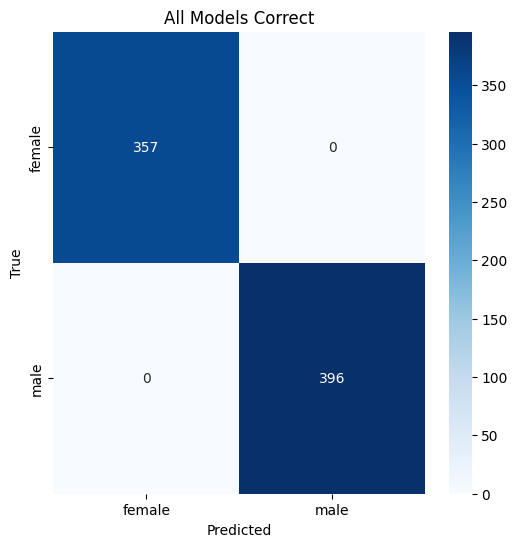

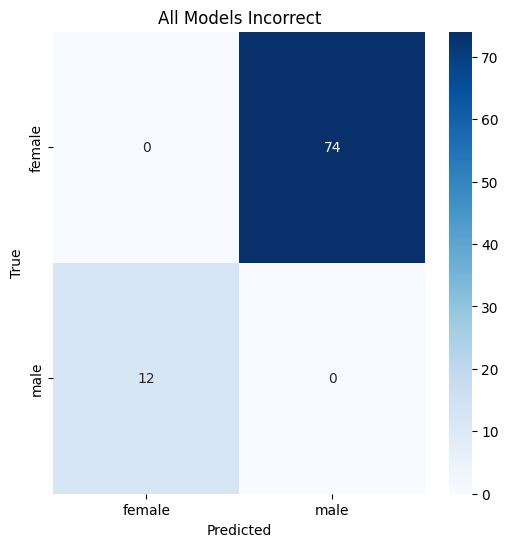

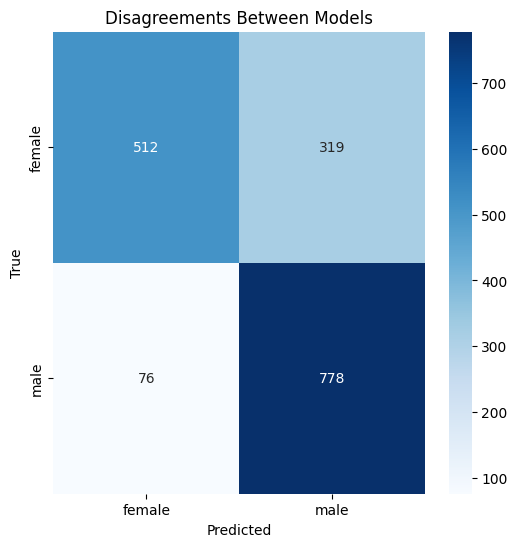

All Models Correct:
[[357   0]
 [  0 396]]

All Models Incorrect:
[[ 0 74]
 [12  0]]

Disagreements Between Models:
[[512 319]
 [ 76 778]]

Total Images Analyzed: 2524


In [7]:
def aggregate_predictions(all_preds, all_labels, class_names):
    num_samples = len(all_labels)
    num_models = len(all_preds)
    num_classes = len(class_names)
    
    # Initialize a matrix to count predictions
    prediction_counts = np.zeros((num_samples, num_classes), dtype=int)
    
    for model_name, preds in all_preds.items():
        for i in range(num_samples):
            prediction_counts[i, preds[i]] += 1
    
    return prediction_counts

prediction_counts = aggregate_predictions(all_preds, all_labels, class_names)

def create_comparison_confusion_matrices(prediction_counts, all_labels, class_names):
    num_samples = len(all_labels)
    num_classes = len(class_names)
    
    # Initialize confusion matrices
    all_correct_matrix = np.zeros((num_classes, num_classes), dtype=int)
    all_incorrect_matrix = np.zeros((num_classes, num_classes), dtype=int)
    disagreements_matrix = np.zeros((num_classes, num_classes), dtype=int)
    
    for i in range(num_samples):
        true_label = all_labels[i]
        pred_counts = prediction_counts[i]
        
        # All models correct
        if pred_counts[true_label] == len(all_preds):
            all_correct_matrix[true_label, true_label] += 1
        
        # All models incorrect
        elif pred_counts[true_label] == 0:
            pred_label = np.argmax(pred_counts)
            all_incorrect_matrix[true_label, pred_label] += 1
        
        # Disagreements
        else:
            pred_label = np.argmax(pred_counts)
            disagreements_matrix[true_label, pred_label] += 1
    
    return all_correct_matrix, all_incorrect_matrix, disagreements_matrix

all_correct_matrix, all_incorrect_matrix, disagreements_matrix = create_comparison_confusion_matrices(
    prediction_counts, all_labels, class_names
)

def plot_comparison_confusion_matrix(cm, title, class_names):
    plt.figure(figsize=(6, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_names, yticklabels=class_names)
    plt.title(title)
    plt.xlabel('Predicted')
    plt.ylabel('True')
    plt.show()

# Plot all models correct
plot_comparison_confusion_matrix(all_correct_matrix, 'All Models Correct', class_names)

# Plot all models incorrect
plot_comparison_confusion_matrix(all_incorrect_matrix, 'All Models Incorrect', class_names)

# Plot disagreements between models
plot_comparison_confusion_matrix(disagreements_matrix, 'Disagreements Between Models', class_names)

def analyze_comparison_matrices(all_correct_matrix, all_incorrect_matrix, disagreements_matrix, class_names):
    print("All Models Correct:")
    print(all_correct_matrix)
    print("\nAll Models Incorrect:")
    print(all_incorrect_matrix)
    print("\nDisagreements Between Models:")
    print(disagreements_matrix)
    
    # Total images analyzed
    total_images = np.sum(all_correct_matrix) + np.sum(all_incorrect_matrix) + np.sum(disagreements_matrix)
    print(f"\nTotal Images Analyzed: {total_images}")

analyze_comparison_matrices(all_correct_matrix, all_incorrect_matrix, disagreements_matrix, class_names)



In [8]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import torchvision
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision import models
import torch.nn as nn
from collections import defaultdict

# Function to compute model agreement matrices
def compute_agreement_matrix(all_preds, all_labels):
    model_names = list(all_preds.keys())
    num_models = len(model_names)
    agreement_matrix = np.zeros((num_models, num_models))
    for i, model_1 in enumerate(model_names):
        for j, model_2 in enumerate(model_names):
            if i <= j:  # Avoid redundant computations
                agreements = np.sum((np.array(all_preds[model_1]) == np.array(all_labels)) &
                                    (np.array(all_preds[model_2]) == np.array(all_labels)))
                total_samples = len(all_labels)
                agreement_matrix[i, j] = agreements / total_samples
                agreement_matrix[j, i] = agreement_matrix[i, j]
    # normalize the matrix
    for i in range(num_models):
        for j in range(num_models):
            if i <= j:
                agreement_matrix[i, j] = agreement_matrix[i, j] / agreement_matrix[i, i]
                agreement_matrix[j, i] = agreement_matrix[i, j]
                agreement_matrix[i, i] = 1.0  # Agreement with itself is 1.0
    return agreement_matrix, model_names
# Function to collect predictions for standard models
def collect_predictions_all(models_dict, dann_model_dict, dataloader, device):
    all_preds = {model_name: [] for model_name in models_dict}
    all_labels = []
    dann_preds = {model_name: [] for model_name in dann_model_dict}
    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            all_labels.extend(labels.cpu().numpy())
            for model_name, model in models_dict.items():
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                all_preds[model_name].extend(preds.cpu().numpy())
            for model_name, model in dann_model_dict.items():
                task_output, _ = model(inputs)
                _, preds = torch.max(task_output, 1)
                dann_preds[model_name].extend(preds.cpu().numpy())

    return all_preds, np.array(all_labels), dann_preds


# Collect predictions for both models
all_preds, all_labels, dann_preds = collect_predictions_all(models_dict, dann_model_dict, balanced_test_dataloader, device)

all_preds['DANN_model'] = dann_preds['DANN_model']

# Now you can proceed with your analysis as you have synchronized labels and predictions
male_indices = [i for i, label in enumerate(all_labels) if label == 1]
female_indices = [i for i, label in enumerate(all_labels) if label == 0]

# Split predictions for male and female samples
male_preds = {model: [all_preds[model][i] for i in male_indices] for model in all_preds}
female_preds = {model: [all_preds[model][i] for i in female_indices] for model in all_preds}

male_labels = [all_labels[i] for i in male_indices]
female_labels = [all_labels[i] for i in female_indices]


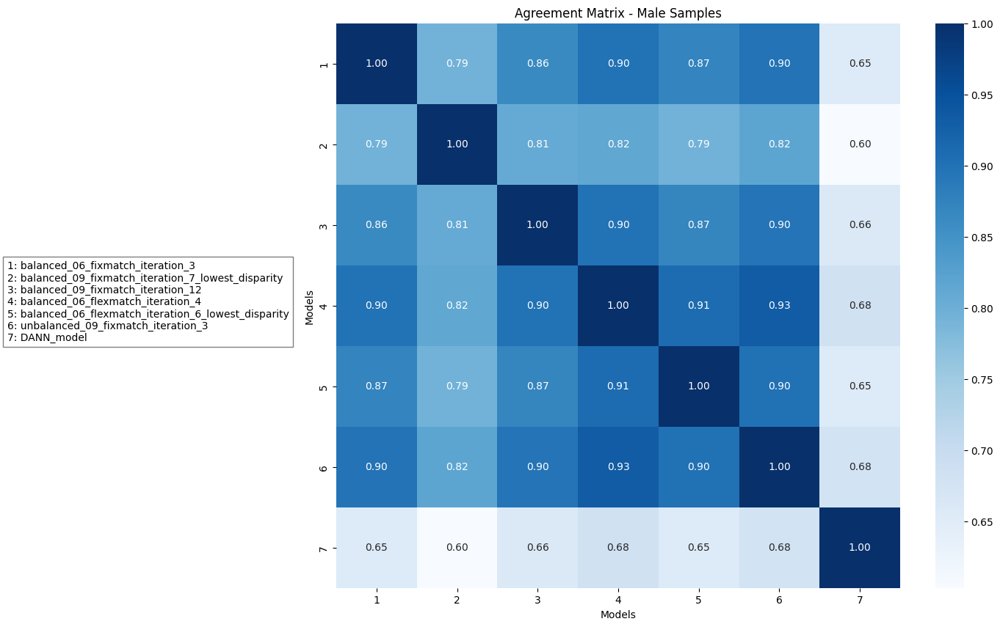

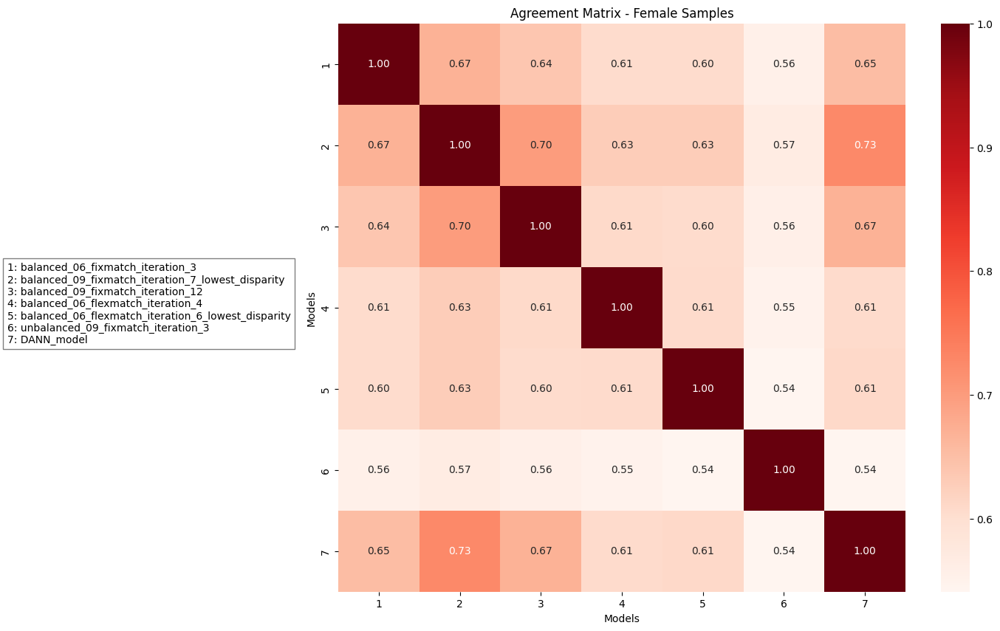

Model balanced_06_fixmatch_iteration_3 has 29 unique failure cases.


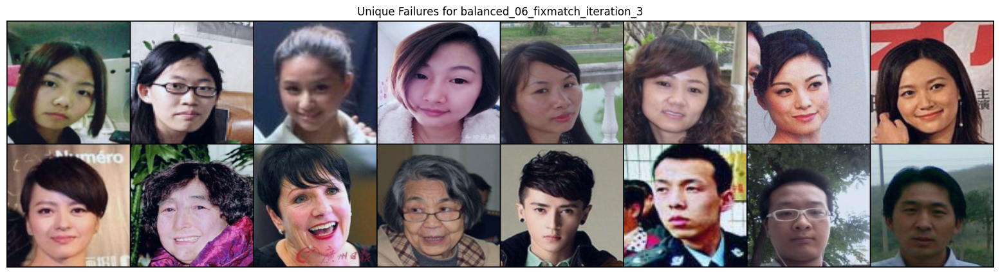

Model balanced_09_fixmatch_iteration_7_lowest_disparity has 55 unique failure cases.


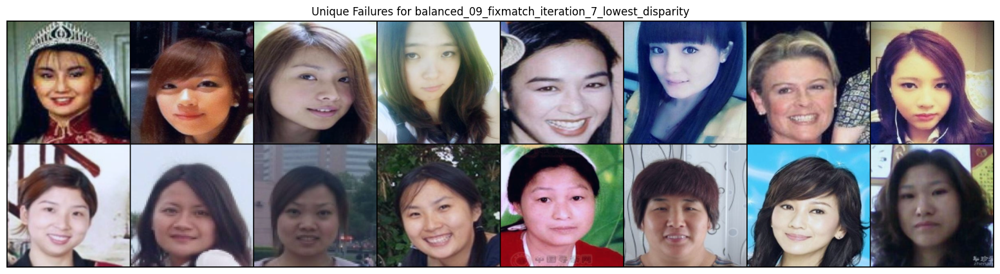

Model balanced_09_fixmatch_iteration_12 has 15 unique failure cases.


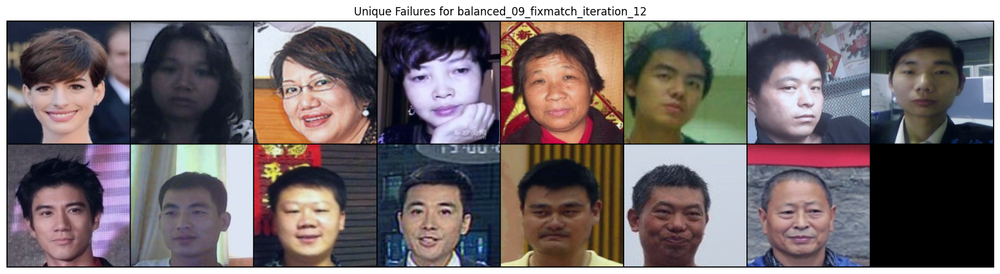

Model balanced_06_flexmatch_iteration_4 has 10 unique failure cases.


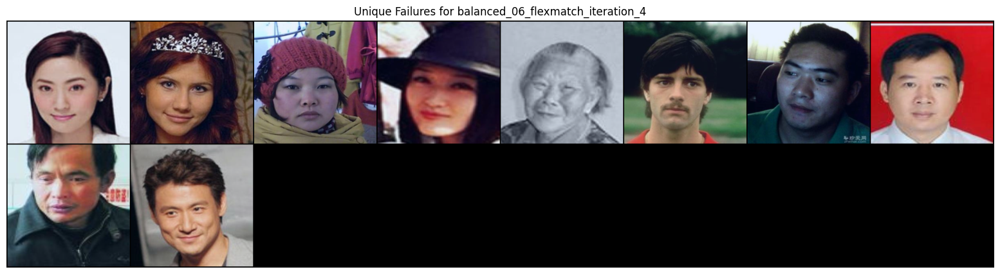

Model balanced_06_flexmatch_iteration_6_lowest_disparity has 31 unique failure cases.


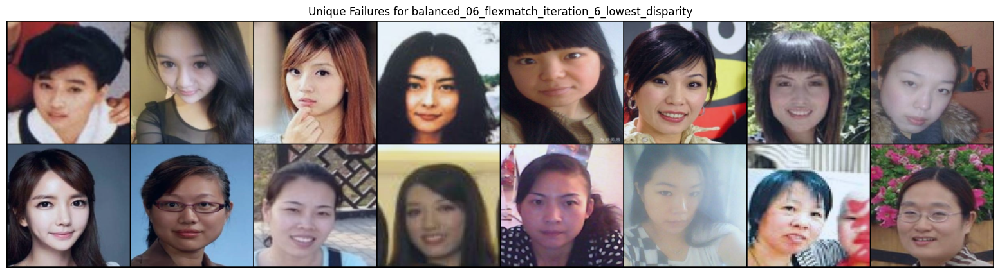

Model unbalanced_09_fixmatch_iteration_3 has 50 unique failure cases.


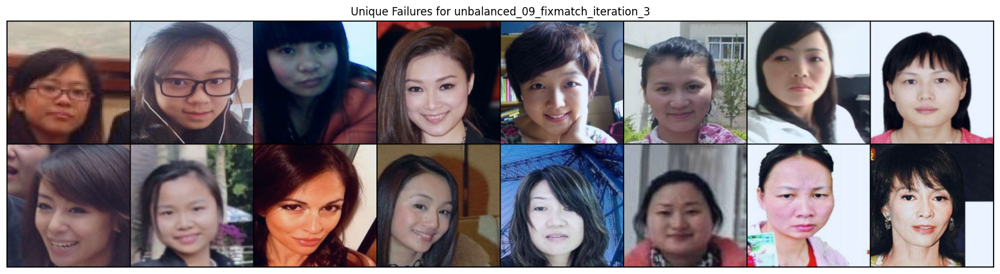

Model DANN_model has 287 unique failure cases.


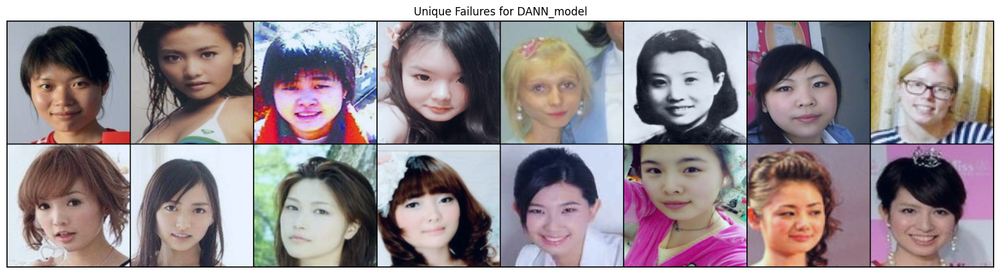

Class-wise accuracy for balanced_06_fixmatch_iteration_3: defaultdict(<class 'int'>, {1: 0.9088748019017433, 0: 0.7076069730586371})
Class-wise accuracy for balanced_09_fixmatch_iteration_7_lowest_disparity: defaultdict(<class 'int'>, {1: 0.8201267828843106, 0: 0.786053882725832})
Class-wise accuracy for balanced_09_fixmatch_iteration_12: defaultdict(<class 'int'>, {1: 0.9096671949286846, 0: 0.7171156893819335})
Class-wise accuracy for balanced_06_flexmatch_iteration_4: defaultdict(<class 'int'>, {1: 0.9548335974643423, 0: 0.6497622820919176})
Class-wise accuracy for balanced_06_flexmatch_iteration_6_lowest_disparity: defaultdict(<class 'int'>, {1: 0.9144215530903328, 0: 0.659270998415214})
Class-wise accuracy for unbalanced_09_fixmatch_iteration_3: defaultdict(<class 'int'>, {1: 0.9532488114104596, 0: 0.5776545166402536})
Class-wise accuracy for DANN_model: defaultdict(<class 'int'>, {1: 0.7004754358161648, 0: 0.8827258320126783})


In [9]:

def plot_agreement_matrix(matrix, model_names, title, cmap='Blues'):
    num_models = len(model_names)
    model_index = [str(i) for i in range(1, num_models + 1)]
    
    model_legends = [f"{i+1}: {model}" for i, model in enumerate(model_names)]
    legend_text = "\n".join(model_legends)

    # Create a figure with extra space on the left
    fig, ax = plt.subplots(figsize=(16, 10))
    plt.subplots_adjust(left=0.3)  # Increase left margin to fit legend

    # Plot heatmap
    sns.heatmap(matrix, annot=True, fmt='.2f', xticklabels=model_index, yticklabels=model_index, cmap=cmap, ax=ax)
    ax.set_title(title)
    ax.set_xlabel("Models")
    ax.set_ylabel("Models")

    # Add legend text outside the heatmap
    fig.text(0.02, 0.5, legend_text, ha="left", va="center", fontsize=10, bbox=dict(facecolor='white', alpha=0.5))

    # Save the figure with padding to prevent cutting off the text
    plt.savefig(title + '.png', bbox_inches='tight')
    plt.show()

# Function to analyze unique failure cases
def analyze_unique_failures(all_preds, all_labels):
    num_samples = len(all_labels)
    failure_cases = {model_name: [] for model_name in all_preds}
    
    for i in range(num_samples):
        label = all_labels[i]
        misclassified_by = [model_name for model_name in all_preds if all_preds[model_name][i] != label]
        
        if len(misclassified_by) == 1:  # Unique failure case
            failure_cases[misclassified_by[0]].append(i)
    return failure_cases

# Function to compute accuracy per class
def compute_classwise_accuracy(all_preds, all_labels):
    class_accuracies = defaultdict(lambda: defaultdict(int))
    class_counts = defaultdict(int)
    
    for i, label in enumerate(all_labels):
        class_counts[label] += 1
        for model_name in all_preds:
            if all_preds[model_name][i] == label:
                class_accuracies[model_name][label] += 1
    for model_name in class_accuracies:
        for label in class_counts:
            class_accuracies[model_name][label] /= class_counts[label]
    return class_accuracies

# Function to visualize misclassified samples
def visualize_misclassified_samples(dataset, indices, title, class_names):
    images = []
    labels = []
    for idx in indices[:16]:  # Show up to 16 images
        img, label = dataset[idx]
        images.append(img)
        labels.append(class_names[label])
    
    images = torch.stack(images)
    images = torchvision.utils.make_grid(images, padding=2, normalize=True)
    
    plt.figure(figsize=(20, 5))
    plt.imshow(images.permute(1, 2, 0))
    plt.axis("off")
    plt.title(title)
    plt.savefig(title + '.png')
    plt.show()

male_agreement_matrix, model_names = compute_agreement_matrix(male_preds, male_labels)
female_agreement_matrix, _ = compute_agreement_matrix(female_preds, female_labels)

plot_agreement_matrix(male_agreement_matrix, model_names, "Agreement Matrix - Male Samples", cmap='Blues')
plot_agreement_matrix(female_agreement_matrix, model_names, "Agreement Matrix - Female Samples", cmap='Reds')

# Analyze unique failure cases
unique_failures = analyze_unique_failures(all_preds, all_labels)
for model, indices in unique_failures.items():
    print(f"Model {model} has {len(indices)} unique failure cases.")
    if len(indices) > 0:
        visualize_misclassified_samples(balanced_test_dataset, indices, f"Unique Failures for {model}", class_names)

# Compute class-wise accuracy
disparities = compute_classwise_accuracy(all_preds, all_labels)
for model, acc in disparities.items():
    print(f"Class-wise accuracy for {model}: {acc}")


### Averaging Faces

C:\Users\haohu\AppData\Local\Temp\ipykernel_21980\3147354437.py:148: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=

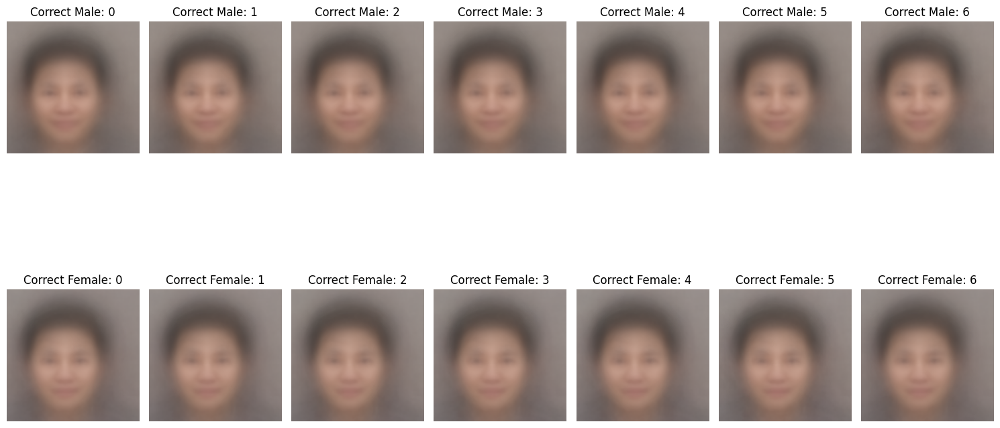

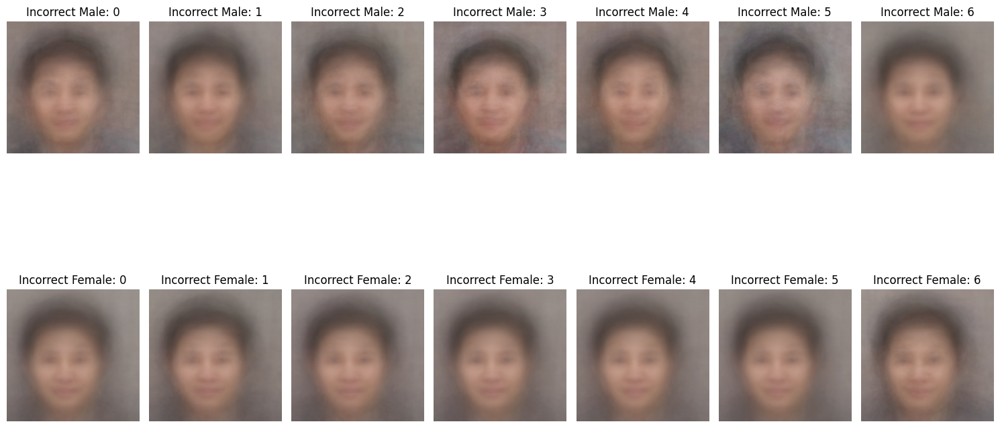

In [ ]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from collections import defaultdict
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision import transforms
import torchvision.models as models
import torch.nn as nn
import os

# Load dataset and models
aaf_dataset_path = "../Pseudo-Labeling/gender_classification_dataset_asia"
balanced_test_folder = os.path.join(aaf_dataset_path, "Test_balanced")
transforms_val = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
balanced_test_dataset = ImageFolder(balanced_test_folder, transform=transforms_val)
balanced_test_dataloader = DataLoader(balanced_test_dataset, batch_size=16, shuffle=True, num_workers=4)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


# Model paths for different models
model_balanced_06_fixmatch_iteration_3 = '../Pseudo-Labeling/10_iterations_0.6_3_balanced_best.pth'
model_balanced_09_fixmatch_iteration_7_lowest_disparity = '../Pseudo-Labeling/method_1_0.9_7_balanced_best.pth'
model_balanced_09_fixmatch_iteration_12 = '../Pseudo-Labeling/method_1_0.9_12_balanced_best.pth'
model_balanced_06_flexmatch_iteration_4 = '../Pseudo-Labeling/FlexMatch_4_best.pth'
model_balanced_06_flexmatch_iteration_6_lowest_disparity = '../Pseudo-Labeling/FlexMatch_6_best.pth'
model_unbalanced_09_fixmatch_iteration_3 = '../Pseudo-Labeling/method_1_model-0.9_3_unbalanced_best.pth'
DANN_model = '../Unsupervised-Domain/dann_model.pth'

models_dict = {
    'balanced_06_fixmatch_iteration_3': load_model(model_balanced_06_fixmatch_iteration_3, device),
    'balanced_09_fixmatch_iteration_7_lowest_disparity': load_model(model_balanced_09_fixmatch_iteration_7_lowest_disparity, device),
    'balanced_09_fixmatch_iteration_12': load_model(model_balanced_09_fixmatch_iteration_12, device),
    'balanced_06_flexmatch_iteration_4': load_model(model_balanced_06_flexmatch_iteration_4, device),
    'balanced_06_flexmatch_iteration_6_lowest_disparity': load_model(model_balanced_06_flexmatch_iteration_6_lowest_disparity, device),
    'unbalanced_09_fixmatch_iteration_3': load_model(model_unbalanced_09_fixmatch_iteration_3, device)
}
dann_model_dict = {
    'DANN_model': load_dann_model(DANN_model, device)
}

# Load models (assuming models_dict is already populated)
model_names = list(models_dict.keys()) + list(dann_model_dict.keys())

# Function to compute and visualize average faces
def compute_average_face(dataset, indices):
    if len(indices) == 0:
        return np.zeros((224, 224, 3), dtype=np.uint8)  # Return blank image if no indices

    avg_face = np.zeros((224, 224, 3), dtype=np.float32)  # Ensure correct shape
    count = 0

    for idx in indices:
        img, _ = dataset[idx]  # Load image (tensor)

        # Convert tensor to NumPy array
        img = img.permute(1, 2, 0).cpu().numpy()  # Change shape from (C, H, W) → (H, W, C)

        # Undo normalization 
        mean = np.array([0.485, 0.456, 0.406])
        std = np.array([0.229, 0.224, 0.225])
        img = img * std + mean  # Reverse normalization
        img = np.clip(img, 0, 1)  # Clip to valid range
        img = (img * 255).astype(np.uint8)  # Rescale to 0-255

        img = cv2.resize(img, (224, 224))  # Resize to standard size
        avg_face += img
        count += 1

    avg_face /= max(count, 1)  # Avoid division by zero
    return avg_face.astype(np.uint8)

# Compute and plot average faces by each model's correct and incorrect predictions, separated by gender class
def compute_average_faces_by_prediction(dataset, all_preds, all_labels, model_names):
    # Initialize dictionaries to store correct and incorrect male/female indices
    correct_male_indices = defaultdict(list)
    incorrect_male_indices = defaultdict(list)
    correct_female_indices = defaultdict(list)
    incorrect_female_indices = defaultdict(list)
    
    # Separate the correct and incorrect predictions for each model
    for model_name in model_names:
        for idx in range(len(all_preds[model_name])):
            label = all_labels[idx]
            pred = all_preds[model_name][idx]
            
            # Split by gender
            if label == 0:  # Female
                if pred == label:
                    correct_female_indices[model_name].append(idx)
                else:
                    incorrect_female_indices[model_name].append(idx)
            elif label == 1:  # Male
                if pred == label:
                    correct_male_indices[model_name].append(idx)
                else:
                    incorrect_male_indices[model_name].append(idx)
    
    # Plotting average faces for correct/incorrect male and female samples
    fig, axes = plt.subplots(2, len(model_names), figsize=(15, 10))  # Adjust size as needed
    
    for i, model_name in enumerate(model_names):
        # Compute average faces for each category
        correct_male_face = compute_average_face(dataset, correct_male_indices[model_name])
        incorrect_male_face = compute_average_face(dataset, incorrect_male_indices[model_name])
        correct_female_face = compute_average_face(dataset, correct_female_indices[model_name])
        incorrect_female_face = compute_average_face(dataset, incorrect_female_indices[model_name])
        
        # Plot average faces for correct and incorrect male/female samples for each model
        axes[0, i].imshow(correct_male_face)
        axes[0, i].set_title(f" Model {i+1}: Correct Male")
        axes[0, i].axis("off")
        
        axes[1, i].imshow(correct_female_face)
        axes[1, i].set_title(f" Model {i+1}: Correct Female")
        axes[1, i].axis("off")
    
    plt.tight_layout()
    plt.savefig("DeepAverageFacesByPrediction_Correct.png")
    plt.show()

    # Plot incorrect predictions
    fig, axes = plt.subplots(2, len(model_names), figsize=(15, 10))  # Adjust size as needed
    
    for i, model_name in enumerate(model_names):
        # Compute average faces for each category
        incorrect_male_face = compute_average_face(dataset, incorrect_male_indices[model_name])
        incorrect_female_face = compute_average_face(dataset, incorrect_female_indices[model_name])
        
        # Plot average faces for incorrect male/female samples for each model
        axes[0, i].imshow(incorrect_male_face)
        axes[0, i].set_title(f" Model {i+1}: Incorrect Male")
        axes[0, i].axis("off")
        
        axes[1, i].imshow(incorrect_female_face)
        axes[1, i].set_title(f" Model {i+1}: Incorrect Female")
        axes[1, i].axis("off")
    
    plt.tight_layout()
    plt.savefig("DeepAverageFacesByPrediction_Incorrect.png")
    plt.show()

# Load dataset and models
aaf_dataset_path = "../Pseudo-Labeling/gender_classification_dataset_asia"
balanced_test_folder = os.path.join(aaf_dataset_path, "Test_balanced")
transforms_val = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
balanced_test_dataset = ImageFolder(balanced_test_folder, transform=transforms_val)
balanced_test_dataloader = DataLoader(balanced_test_dataset, batch_size=16, shuffle=True, num_workers=4)


# Model paths for different models
model_balanced_06_fixmatch_iteration_3 = '../Pseudo-Labeling/10_iterations_0.6_3_balanced_best.pth'
model_balanced_09_fixmatch_iteration_7_lowest_disparity = '../Pseudo-Labeling/method_1_0.9_7_balanced_best.pth'
model_balanced_09_fixmatch_iteration_12 = '../Pseudo-Labeling/method_1_0.9_12_balanced_best.pth'
model_balanced_06_flexmatch_iteration_4 = '../Pseudo-Labeling/FlexMatch_4_best.pth'
model_balanced_06_flexmatch_iteration_6_lowest_disparity = '../Pseudo-Labeling/FlexMatch_6_best.pth'
model_unbalanced_09_fixmatch_iteration_3 = '../Pseudo-Labeling/method_1_model-0.9_3_unbalanced_best.pth'
DANN_model = '../Unsupervised-Domain/dann_model.pth'

models_dict = {
    'balanced_06_fixmatch_iteration_3': load_model(model_balanced_06_fixmatch_iteration_3, device),
    'balanced_09_fixmatch_iteration_7_lowest_disparity': load_model(model_balanced_09_fixmatch_iteration_7_lowest_disparity, device),
    'balanced_09_fixmatch_iteration_12': load_model(model_balanced_09_fixmatch_iteration_12, device),
    'balanced_06_flexmatch_iteration_4': load_model(model_balanced_06_flexmatch_iteration_4, device),
    'balanced_06_flexmatch_iteration_6_lowest_disparity': load_model(model_balanced_06_flexmatch_iteration_6_lowest_disparity, device),
    'unbalanced_09_fixmatch_iteration_3': load_model(model_unbalanced_09_fixmatch_iteration_3, device)
}
dann_model_dict = {
    'DANN_model': load_dann_model(DANN_model, device)
}

# Load models (assuming models_dict is already populated)
model_names = list(models_dict.keys()) + list(dann_model_dict.keys())

# Collect predictions
# Function to collect predictions for standard models
def collect_predictions_all(models_dict, dann_model_dict, dataloader, device):
    all_preds = {model_name: [] for model_name in models_dict}
    all_labels = []
    dann_preds = {model_name: [] for model_name in dann_model_dict}
    with torch.no_grad():
        for inputs, labels in dataloader:
            inputs, labels = inputs.to(device), labels.to(device)
            all_labels.extend(labels.cpu().numpy())
            for model_name, model in models_dict.items():
                outputs = model(inputs)
                _, preds = torch.max(outputs, 1)
                all_preds[model_name].extend(preds.cpu().numpy())
            for model_name, model in dann_model_dict.items():
                task_output, _ = model(inputs)
                _, preds = torch.max(task_output, 1)
                dann_preds[model_name].extend(preds.cpu().numpy())

    return all_preds, np.array(all_labels), dann_preds


# Collect predictions for both models
all_preds, all_labels, dann_preds = collect_predictions_all(models_dict, dann_model_dict, balanced_test_dataloader, device)

all_preds['DANN_model'] = dann_preds['DANN_model']
# Compute and visualize average faces
compute_average_faces_by_prediction(balanced_test_dataset, all_preds, all_labels, model_names)


c:\Users\haohu\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\haohu\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
C:\Users\haohu\AppData\Local\Temp\ipykernel_10344\3147354437.py:148: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpic

Explaining model: balanced_06_fixmatch_iteration_3 with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

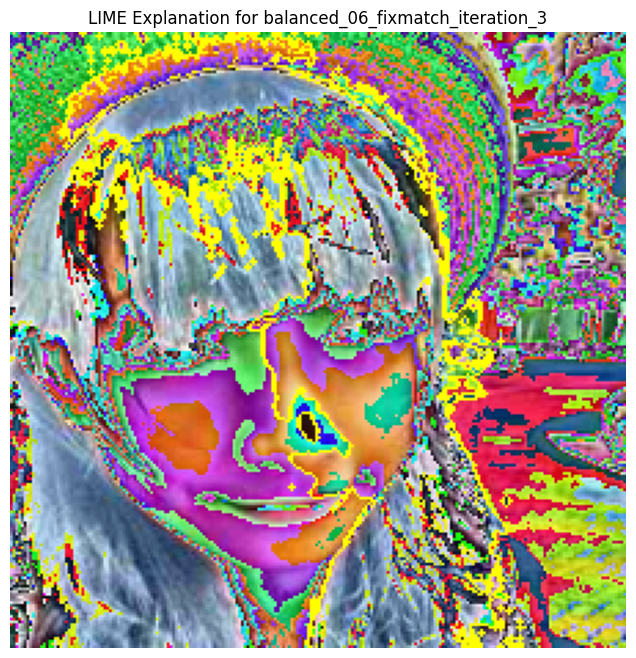

Explaining model: balanced_09_fixmatch_iteration_7_lowest_disparity with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

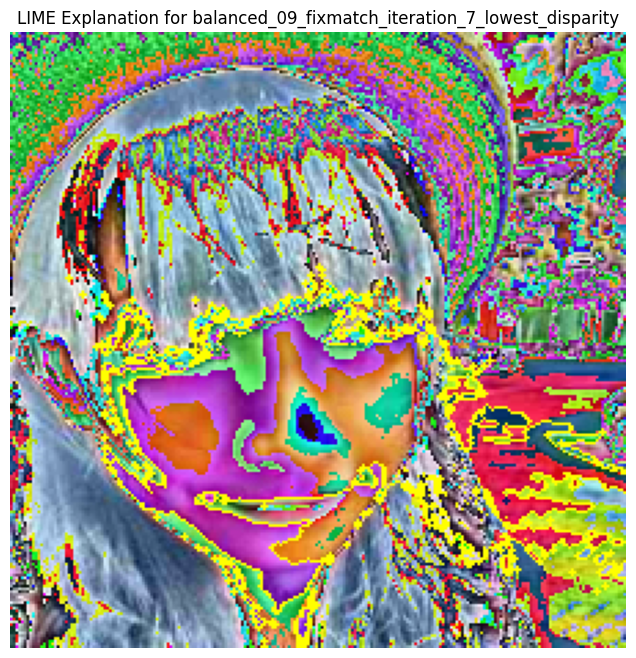

Explaining model: balanced_09_fixmatch_iteration_12 with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

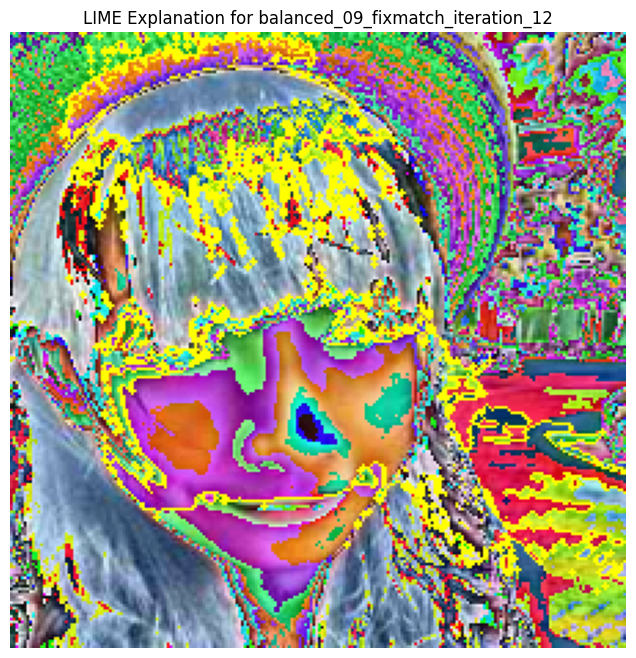

Explaining model: balanced_06_flexmatch_iteration_4 with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

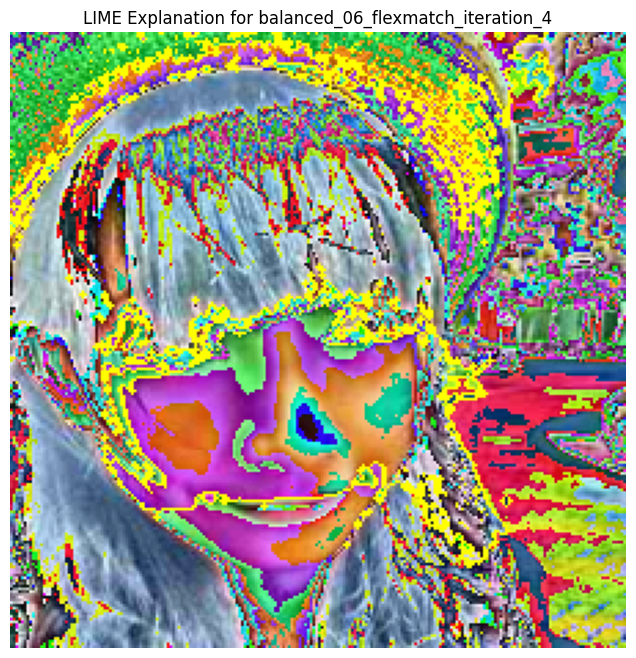

Explaining model: balanced_06_flexmatch_iteration_6_lowest_disparity with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

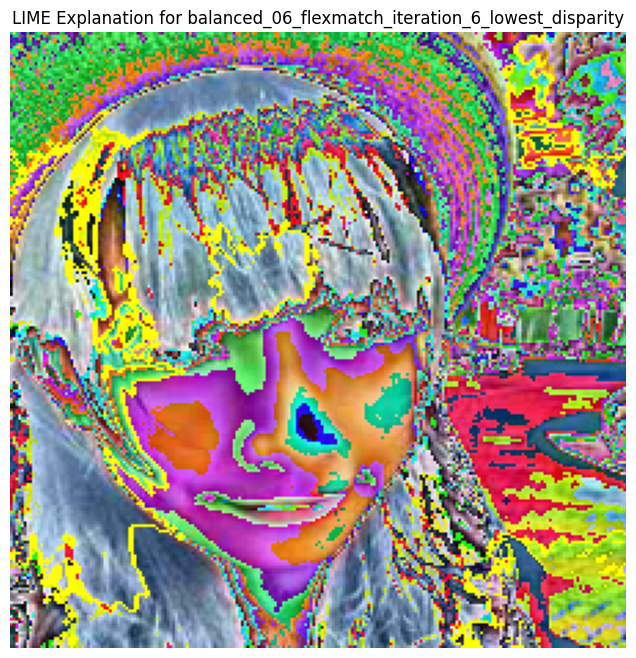

Explaining model: unbalanced_09_fixmatch_iteration_3 with LIME


  0%|          | 0/1000 [00:00<?, ?it/s]

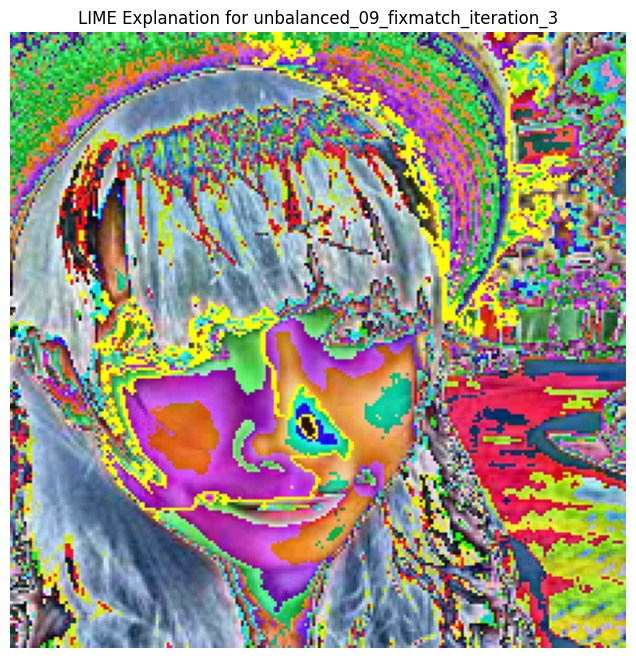

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

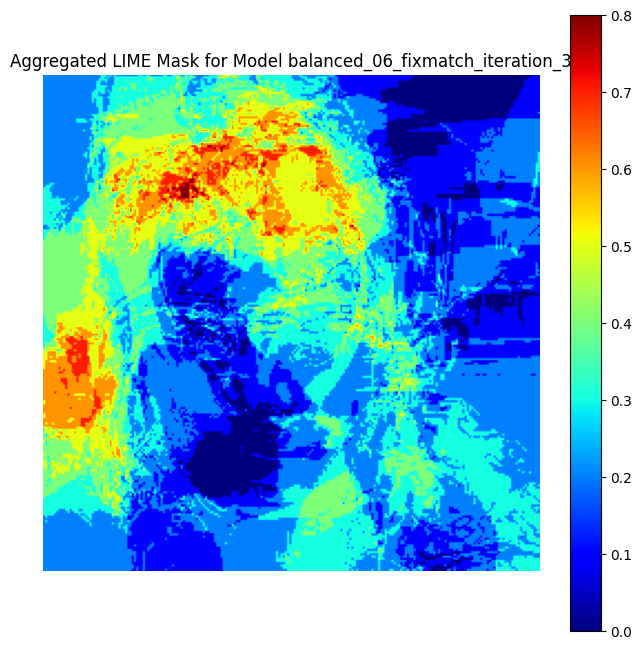

Generating Grad-CAM for model: balanced_06_fixmatch_iteration_3


c:\Users\haohu\AppData\Local\Programs\Python\Python311\Lib\site-packages\torch\nn\modules\module.py:1827: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


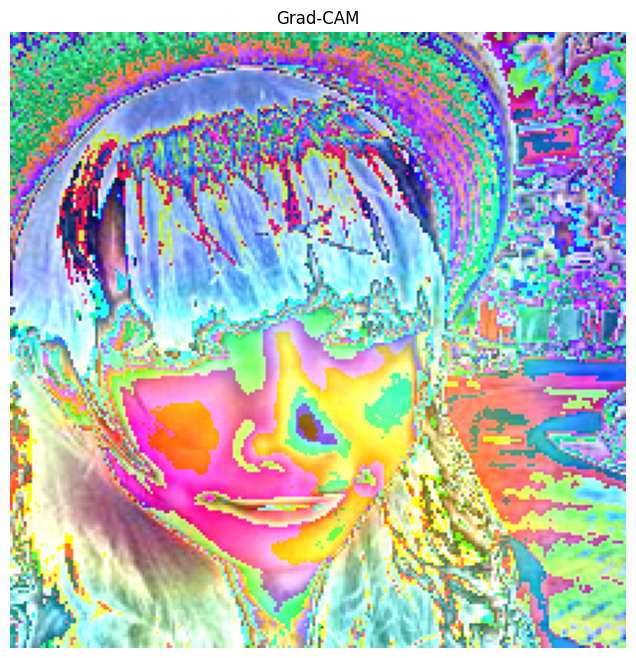

Aggregating explanations for balanced_06_fixmatch_iteration_3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

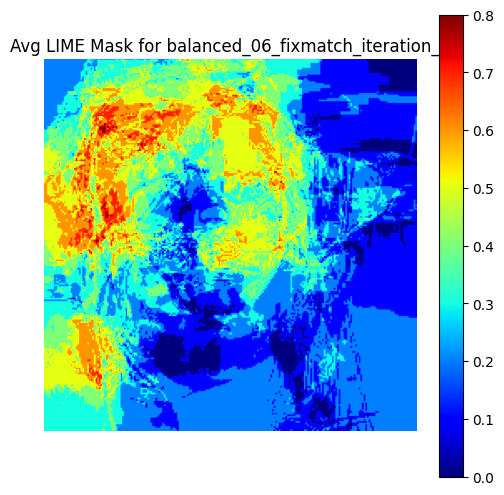

Aggregating explanations for balanced_09_fixmatch_iteration_7_lowest_disparity


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

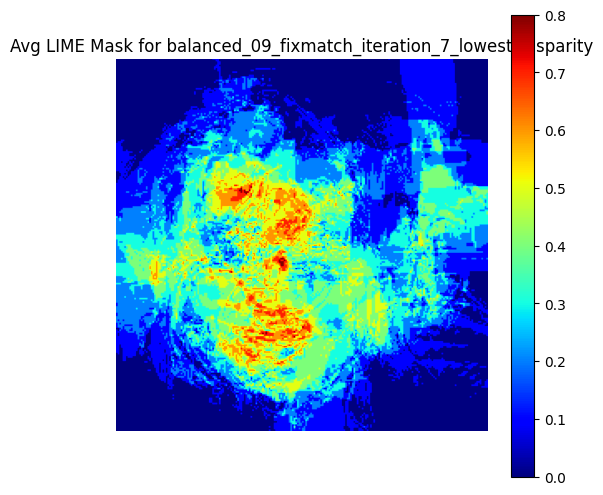

Aggregating explanations for balanced_09_fixmatch_iteration_12


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

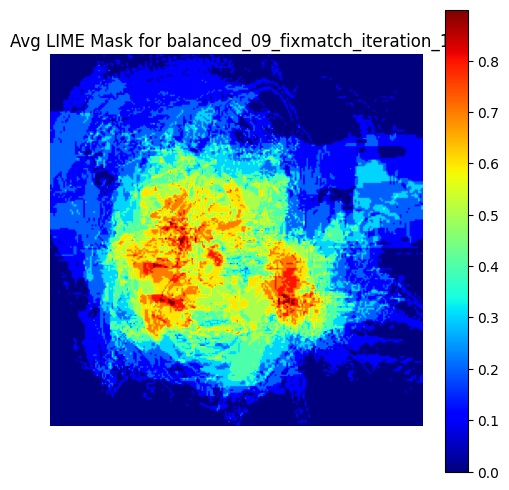

Aggregating explanations for balanced_06_flexmatch_iteration_4


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

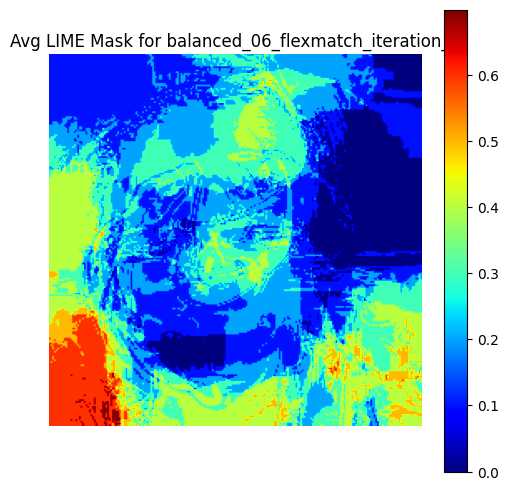

Aggregating explanations for balanced_06_flexmatch_iteration_6_lowest_disparity


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

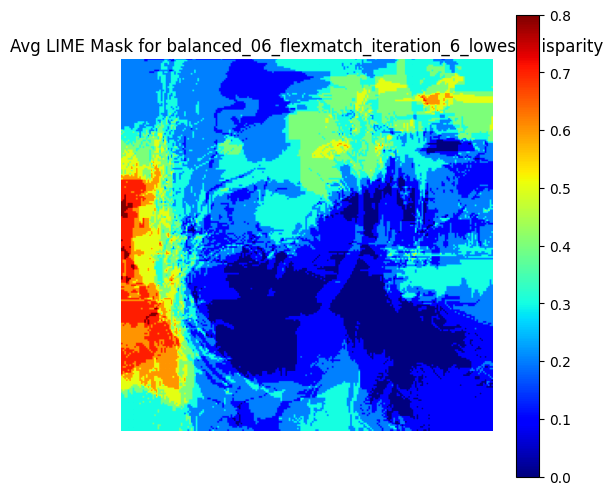

Aggregating explanations for unbalanced_09_fixmatch_iteration_3


  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/1000 [00:00<?, ?it/s]

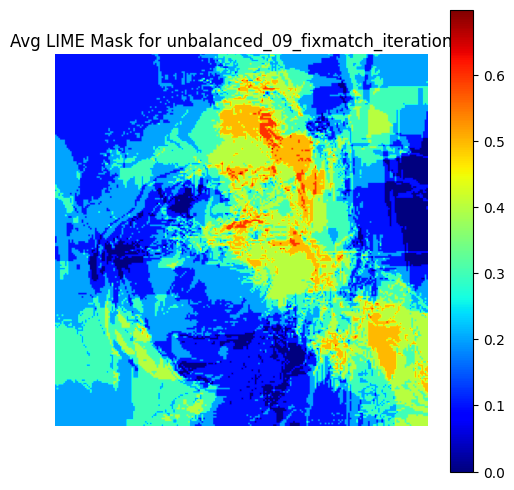

In [5]:
import torch
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
from collections import defaultdict
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
from torchvision import transforms
import torchvision.models as models
import torch.nn as nn
import os
import torch.nn as nn
import torch.nn.functional as F
from lime import lime_image
from skimage.segmentation import mark_boundaries
from PIL import Image


# Load dataset and models
aaf_dataset_path = "../Pseudo-Labeling/gender_classification_dataset_asia"
balanced_test_folder = os.path.join(aaf_dataset_path, "Test_balanced")
transforms_val = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])
balanced_test_dataset = ImageFolder(balanced_test_folder, transform=transforms_val)
balanced_test_dataloader = DataLoader(balanced_test_dataset, batch_size=16, shuffle=True, num_workers=4)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")


# Model paths for different models
model_balanced_06_fixmatch_iteration_3 = '../Pseudo-Labeling/10_iterations_0.6_3_balanced_best.pth'
model_balanced_09_fixmatch_iteration_7_lowest_disparity = '../Pseudo-Labeling/method_1_0.9_7_balanced_best.pth'
model_balanced_09_fixmatch_iteration_12 = '../Pseudo-Labeling/method_1_0.9_12_balanced_best.pth'
model_balanced_06_flexmatch_iteration_4 = '../Pseudo-Labeling/FlexMatch_4_best.pth'
model_balanced_06_flexmatch_iteration_6_lowest_disparity = '../Pseudo-Labeling/FlexMatch_6_best.pth'
model_unbalanced_09_fixmatch_iteration_3 = '../Pseudo-Labeling/method_1_model-0.9_3_unbalanced_best.pth'
DANN_model = '../Unsupervised-Domain/dann_model.pth'

models_dict = {
    'balanced_06_fixmatch_iteration_3': load_model(model_balanced_06_fixmatch_iteration_3, device),
    'balanced_09_fixmatch_iteration_7_lowest_disparity': load_model(model_balanced_09_fixmatch_iteration_7_lowest_disparity, device),
    'balanced_09_fixmatch_iteration_12': load_model(model_balanced_09_fixmatch_iteration_12, device),
    'balanced_06_flexmatch_iteration_4': load_model(model_balanced_06_flexmatch_iteration_4, device),
    'balanced_06_flexmatch_iteration_6_lowest_disparity': load_model(model_balanced_06_flexmatch_iteration_6_lowest_disparity, device),
    'unbalanced_09_fixmatch_iteration_3': load_model(model_unbalanced_09_fixmatch_iteration_3, device)
}
dann_model_dict = {
    'DANN_model': load_dann_model(DANN_model, device)
}

# Load models (assuming models_dict is already populated)
model_names = list(models_dict.keys()) + list(dann_model_dict.keys())



def explain_with_lime(model, image, device, transform, num_features=5, num_samples=1000):
    """
    Use LIME to explain the model's prediction on a given image.
    :param model: PyTorch model.
    :param image: NumPy array in shape (H, W, C) with pixel values 0-255.
    :param device: Device on which the model is running.
    :param transform: Preprocessing transform to convert a PIL image into a tensor.
    :param num_features: Number of superpixels to show.
    :param num_samples: Number of perturbed samples for LIME.
    :return: Tuple of (temp image, mask, full explanation object)
    """
    explainer = lime_image.LimeImageExplainer()
    
    def predict_fn(images):
        images_transformed = []
        for img in images:
            # Convert numpy array to PIL image
            pil_img = Image.fromarray(img.astype(np.uint8))
            img_tensor = transform(pil_img)
            images_transformed.append(img_tensor)
        images_transformed = torch.stack(images_transformed).to(device)
        with torch.no_grad():
            outputs = model(images_transformed)
            # Convert logits to probabilities
            probs = torch.softmax(outputs, dim=1).detach().cpu().numpy()
        return probs

    explanation = explainer.explain_instance(image, predict_fn, top_labels=1, hide_color=0, num_samples=num_samples)
    top_label = explanation.top_labels[0]
    temp, mask = explanation.get_image_and_mask(top_label, positive_only=True,
                                                num_features=num_features, hide_rest=False)
    return temp, mask, explanation

def aggregate_lime_explanations(model, dataset, device, transform, num_samples=1000, num_features=5, sample_count=10):
    """
    Aggregate LIME explanation masks over a set of sample images.
    :param model: PyTorch model.
    :param dataset: Dataset from which sample images are drawn.
    :param device: Device on which the model is running.
    :param transform: Preprocessing transform.
    :param sample_count: Number of images to average.
    :return: Averaged explanation mask.
    """
    aggregated_mask = None
    count = 0
    for i in range(sample_count):
        img, _ = dataset[i]
        # Convert tensor to numpy array and rescale to 0-255
        img_np = img.permute(1, 2, 0).cpu().numpy()
        img_np = (img_np * 255).astype(np.uint8)
        temp, mask, _ = explain_with_lime(model, img_np, device, transform,
                                          num_features=num_features, num_samples=num_samples)
        if aggregated_mask is None:
            aggregated_mask = mask.astype(np.float32)
        else:
            aggregated_mask += mask.astype(np.float32)
        count += 1
    aggregated_mask /= count
    return aggregated_mask

# ----- XAI: Grad-CAM Implementation -----

class GradCAM:
    """
    Grad-CAM implementation for visual explanations. Make sure the model is in eval mode.
    """
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None
        self.activations = None
        self.hook_handles = []
        self._register_hooks()
    
    def _register_hooks(self):
        def forward_hook(module, input, output):
            self.activations = output.detach()
        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0].detach()
        self.hook_handles.append(self.target_layer.register_forward_hook(forward_hook))
        self.hook_handles.append(self.target_layer.register_backward_hook(backward_hook))
    
    def generate_cam(self, input_tensor, class_idx=None):
        self.model.zero_grad()
        output = self.model(input_tensor)
        if class_idx is None:
            class_idx = output.argmax(dim=1).item()
        score = output[:, class_idx]
        score.backward()
        gradients = self.gradients  # shape: (N, C, H, W)
        activations = self.activations  # shape: (N, C, H, W)
        weights = gradients.mean(dim=(2, 3), keepdim=True)  # Global average pooling
        cam = torch.sum(weights * activations, dim=1)
        cam = torch.relu(cam)
        cam = cam.squeeze().cpu().numpy()
        # Resize and normalize the CAM to the size of the input
        cam = cv2.resize(cam, (input_tensor.shape[3], input_tensor.shape[2]))
        cam = (cam - cam.min()) / (cam.max() - cam.min() + 1e-8)
        return cam

    def remove_hooks(self):
        for handle in self.hook_handles:
            handle.remove()

def visualize_gradcam(model, image, device, transform, target_layer, class_idx=None):
    """
    Generate and visualize a Grad-CAM heatmap for a given model and image.
    :param model: PyTorch model.
    :param image: NumPy array (H, W, C) with pixel values 0-255.
    :param device: Device on which the model is running.
    :param transform: Preprocessing transform.
    :param target_layer: Convolutional layer to target for Grad-CAM.
    :param class_idx: Class index to explain (if None, uses predicted class).
    """
    gradcam = GradCAM(model, target_layer)
    model.eval()
    input_tensor = transform(Image.fromarray(image)).unsqueeze(0).to(device)
    cam = gradcam.generate_cam(input_tensor, class_idx)
    gradcam.remove_hooks()
    # Create heatmap using OpenCV
    heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)
    # Superimpose the heatmap onto the original image
    superimposed_img = heatmap * 0.4 + image
    plt.figure(figsize=(8, 8))
    plt.imshow(np.clip(superimposed_img, 0, 255).astype(np.uint8))
    plt.axis("off")
    plt.title("Grad-CAM")
    plt.show()

# ----- Example Integration with Your Analysis Pipeline -----

# Assuming you have already loaded your models in models_dict,
# defined your transforms (transforms_val), device, and test dataset (balanced_test_dataset)
# For demonstration, we pick a sample image from the test dataset.
sample_img, _ = balanced_test_dataset[0]
sample_img_np = sample_img.permute(1, 2, 0).cpu().numpy()
sample_img_np = (sample_img_np * 255).astype(np.uint8)

# Run LIME explanation for each model and display the result.
for model_name, model in models_dict.items():
    print(f"Explaining model: {model_name} with LIME")
    temp, mask, explanation = explain_with_lime(model, sample_img_np, device, transforms_val,
                                                num_features=5, num_samples=1000)
    img_boundry = mark_boundaries(temp, mask)
    plt.figure(figsize=(8, 8))
    plt.imshow(img_boundry)
    plt.title(f"LIME Explanation for {model_name}")
    plt.axis("off")
    plt.show()

# Aggregate LIME explanations for one of the models (e.g., the first model) over a few images.
aggregated_mask = aggregate_lime_explanations(models_dict[model_names[0]], balanced_test_dataset, device, transforms_val, sample_count=10)
plt.figure(figsize=(8, 8))
plt.imshow(aggregated_mask, cmap='jet')
plt.title("Aggregated LIME Mask for Model " + model_names[0])
plt.colorbar()
plt.axis("off")
plt.show()



# For Grad-CAM, we need to pick a target layer. For example, if your model is ResNet-like,
# you might choose the last convolutional layer. (Adjust as needed for your architecture.)
# Here we assume the first model in models_dict has an attribute 'layer4[1].conv2'
target_layer = models_dict[model_names[0]].layer4[1].conv2  # Modify if necessary
print(f"Generating Grad-CAM for model: {model_names[0]}")
visualize_gradcam(models_dict[model_names[0]], sample_img_np, device, transforms_val, target_layer)




# ----- Additional Analysis: Comparing Feature Importance Across Models -----
# One way to compare the importance of features across models is to run the above
# LIME or Grad-CAM explanations on the same set of images and then compare (visually or quantitatively)
# the highlighted regions. For example, you could compute an average explanation mask for each model
# (as shown with aggregate_lime_explanations) and then compare these average maps.

def compare_average_explanations(models_dict, dataset, device, transform, sample_count=10):
    avg_masks = {}
    for model_name, model in models_dict.items():
        print(f"Aggregating explanations for {model_name}")
        avg_mask = aggregate_lime_explanations(model, dataset, device, transform, sample_count=sample_count)
        avg_masks[model_name] = avg_mask
        plt.figure(figsize=(6, 6))
        plt.imshow(avg_mask, cmap='jet')
        plt.title(f"Avg LIME Mask for {model_name}")
        plt.colorbar()
        plt.axis("off")
        plt.show()
    return avg_masks

# Run the comparison
avg_masks = compare_average_explanations(models_dict, balanced_test_dataset, device, transforms_val, sample_count=10)

# Now you have an aggregated explanation (feature importance map) for each model.
# You can inspect these maps to see if certain regions (features) consistently drive predictions
# or if there are noticeable differences that might point to bias in each model.

In [6]:
import shap
import torch.nn.functional as F
import lime
from lime import lime_image
from skimage.segmentation import mark_boundaries


def explain_with_lime(model, image, top_labels=2, hide_color=0, num_samples=1000):
    explainer = lime_image.LimeImageExplainer()
    explanation = explainer.explain_instance(
        image.permute(1, 2, 0).cpu().numpy(), 
        model, 
        top_labels=top_labels, 
        hide_color=hide_color, 
        num_samples=num_samples
    )
    return explanation

def visualize_lime_explanation(explanation, image, label, class_names):
    temp, mask = explanation.get_image_and_mask(
        label, 
        positive_only=True, 
        num_features=5, 
        hide_rest=False
    )
    plt.imshow(mark_boundaries(temp / 2 + 0.5, mask))
    plt.title(f"LIME Explanation for {class_names[label]}")
    plt.axis("off")
    plt.show()

# Example usage for a single image
image, label = balanced_test_dataset[0]  # Get the first image from the dataset
explanation = explain_with_lime(models_dict['balanced_06_fixmatch_iteration_3'], image)
visualize_lime_explanation(explanation, image, label, class_names)


def explain_with_shap(model, dataloader, class_names, num_samples=100):
    # Use a subset of the data for SHAP explanation
    background, _ = next(iter(dataloader))
    background = background[:num_samples].to(device)
    
    # Define a function to wrap the model's predictions
    def predict_fn(images):
        images = torch.tensor(images).to(device)
        with torch.no_grad():
            outputs = model(images)
            return F.softmax(outputs, dim=1).cpu().numpy()
    
    # Create SHAP explainer
    explainer = shap.DeepExplainer(model, background)
    shap_values = explainer.shap_values(background)
    
    # Visualize SHAP values for the first image
    shap.image_plot(shap_values, -background.cpu().numpy(), class_names)

# Example usage for a model
explain_with_shap(models_dict['balanced_06_fixmatch_iteration_3'], balanced_test_dataloader, class_names)

def compare_feature_importance(models_dict, dataloader, class_names, num_samples=100):
    shap_values_dict = {}
    for model_name, model in models_dict.items():
        print(f"Computing SHAP values for {model_name}...")
        explain_with_shap(model, dataloader, class_names, num_samples)
        shap_values_dict[model_name] = explainer.shap_values(background)
    
    # Aggregate SHAP values for comparison
    aggregated_shap = {model_name: np.mean(np.abs(shap_values), axis=0) 
                       for model_name, shap_values in shap_values_dict.items()}
    
    # Plot aggregated SHAP values
    plt.figure(figsize=(10, 6))
    for model_name, shap_vals in aggregated_shap.items():
        plt.plot(shap_vals, label=model_name)
    plt.title("Aggregated SHAP Values Across Models")
    plt.xlabel("Feature Index")
    plt.ylabel("Mean |SHAP Value|")
    plt.legend()
    plt.show()

    # After collecting predictions
all_preds, all_labels, dann_preds = collect_predictions_all(models_dict, dann_model_dict, balanced_test_dataloader, device)
all_preds['DANN_model'] = dann_preds['DANN_model']

# Compute and visualize average faces
compute_average_faces_by_prediction(balanced_test_dataset, all_preds, all_labels, model_names)
# Explain predictions with LIME
image, label = balanced_test_dataset[0]  # Get the first image from the dataset

for model_name, model in models_dict.items():
    print(f"Explaining model: {model_name}")
    explanation = explain_with_lime(model, image)
    visualize_lime_explanation(explanation, image, label, class_names)
    explain_with_shap(model, balanced_test_dataloader, class_names)
    compare_feature_importance(models_dict, balanced_test_dataloader, class_names)



  0%|          | 0/1000 [00:00<?, ?it/s]

TypeError: conv2d() received an invalid combination of arguments - got (numpy.ndarray, Parameter, NoneType, tuple, tuple, tuple, int), but expected one of:
 * (Tensor input, Tensor weight, Tensor bias = None, tuple of ints stride = 1, tuple of ints padding = 0, tuple of ints dilation = 1, int groups = 1)
      didn't match because some of the arguments have invalid types: (!numpy.ndarray!, !Parameter!, !NoneType!, !tuple of (int, int)!, !tuple of (int, int)!, !tuple of (int, int)!, !int!)
 * (Tensor input, Tensor weight, Tensor bias = None, tuple of ints stride = 1, str padding = "valid", tuple of ints dilation = 1, int groups = 1)
      didn't match because some of the arguments have invalid types: (!numpy.ndarray!, !Parameter!, !NoneType!, !tuple of (int, int)!, !tuple of (int, int)!, !tuple of (int, int)!, !int!)
